# **Problem Statement**

## Business Context

Renewable energy sources play an increasingly important role in the global energy mix, as the effort to reduce the environmental impact of energy production increases.

Out of all the renewable energy alternatives, wind energy is one of the most developed technologies worldwide. The U.S Department of Energy has put together a guide to achieving operational efficiency using predictive maintenance practices.

Predictive maintenance uses sensor information and analysis methods to measure and predict degradation and future component capability. The idea behind predictive maintenance is that failure patterns are predictable and if component failure can be predicted accurately and the component is replaced before it fails, the costs of operation and maintenance will be much lower.

The sensors fitted across different machines involved in the process of energy generation collect data related to various environmental factors (temperature, humidity, wind speed, etc.) and additional features related to various parts of the wind turbine (gearbox, tower, blades, break, etc.).

## Objective

“ReneWind” is a company working on improving the machinery/processes involved in the production of wind energy using machine learning and has collected data of generator failure of wind turbines using sensors. They have shared a ciphered version of the data, as the data collected through sensors is confidential (the type of data collected varies with companies). Data has 40 predictors, 20000 observations in the training set and 5000 in the test set.

The objective is to build various classification models, tune them, and find the best one that will help identify failures so that the generators could be repaired before failing/breaking to reduce the overall maintenance cost.
The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model. These will result in repairing costs.
- False negatives (FN) are real failures where there is no detection by the model. These will result in replacement costs.
- False positives (FP) are detections where there is no failure. These will result in inspection costs.

It is given that the cost of repairing a generator is much less than the cost of replacing it, and the cost of inspection is less than the cost of repair.

“1” in the target variables should be considered as “failure” and “0” represents “No failure”.

## Data Description

The data provided is a transformed version of the original data which was collected using sensors.

- Train.csv - To be used for training and tuning of models.
- Test.csv - To be used only for testing the performance of the final best model.

Both the datasets consist of 40 predictor variables and 1 target variable.

# **Installing and Importing the necessary libraries**

In [1]:
# Installing the libraries with the specified version
!pip install scikeras keras-tuner --quiet --no-deps tensorflow==2.18.0 scikit-learn==1.3.2 matplotlib===3.8.3 seaborn==0.13.2 numpy==1.26.4 pandas==2.2.2 -q --user --no-warn-script-location

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 615.5/615.5 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 42.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 32.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 38.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 5.9 MB/s eta 0:00:00


**Note**:
- After running the above cell, kindly restart the runtime (for Google Colab) or notebook kernel (for Jupyter Notebook), and run all cells sequentially from the next cell.
- On executing the above line of code, you might see a warning regarding package dependencies. This error message can be ignored as the above code ensures that all necessary libraries and their dependencies are maintained to successfully execute the code in ***this notebook***.

In [1]:
# import libraries for data manipulation
import numpy as np
import pandas as pd

# import libraries for data visualization
import matplotlib.pyplot as plt
import seaborn as sns
import os

# import libraries for ML, DPreP, ME, MB, MOpt, Fsel
import joblib
from pathlib import Path
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, roc_curve, auc
from sklearn.metrics import precision_score, recall_score, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score, f1_score, RocCurveDisplay
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import RandomizedSearchCV
import tensorflow as tf
import keras_tuner as kt
from tensorflow.keras import layers, models, optimizers, callbacks, regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import SGD, Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras import layers
from tensorflow import keras
from scikeras.wrappers import KerasClassifier

# Classifiers
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier, BaggingClassifier
from xgboost import XGBClassifier


# **Loading the Data**

In [2]:
# uncomment and run the following lines for Google Colab
# drive.mount('/content/drive')
from google.colab import files
uploaded = files.upload()

Saving Train.csv to Train.csv
Saving Test.csv to Test.csv


# **Data Overview**

In [3]:
# 1) Load data & quick overview
train_df = pd.read_csv('Train.csv')
test_df = pd.read_csv('Test.csv')
print("Train shape:", train_df.shape)
print("Test shape:", test_df.shape)

Train shape: (20000, 41)
Test shape: (5000, 41)


### Observation:
1. Initial Train Dataset contain 20,000 rows and 41 columns which
Includes 40 features + Target.
2. Initial Test Dataset contain 5000 rows and 41 columns which
Includes 40 features + Target.

In [4]:
train_df.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.464606,-4.679129,3.101546,0.506130,-0.221083,-2.032511,-2.910870,0.050714,-1.522351,3.761892,...,3.059700,-1.690440,2.846296,2.235198,6.667486,0.443809,-2.369169,2.950578,-3.480324,0
1,3.365912,3.653381,0.909671,-1.367528,0.332016,2.358938,0.732600,-4.332135,0.565695,-0.101080,...,-1.795474,3.032780,-2.467514,1.894599,-2.297780,-1.731048,5.908837,-0.386345,0.616242,0
2,-3.831843,-5.824444,0.634031,-2.418815,-1.773827,1.016824,-2.098941,-3.173204,-2.081860,5.392621,...,-0.257101,0.803550,4.086219,2.292138,5.360850,0.351993,2.940021,3.839160,-4.309402,0
3,1.618098,1.888342,7.046143,-1.147285,0.083080,-1.529780,0.207309,-2.493629,0.344926,2.118578,...,-3.584425,-2.577474,1.363769,0.622714,5.550100,-1.526796,0.138853,3.101430,-1.277378,0
4,-0.111440,3.872488,-3.758361,-2.982897,3.792714,0.544960,0.205433,4.848994,-1.854920,-6.220023,...,8.265896,6.629213,-10.068689,1.222987,-3.229763,1.686909,-2.163896,-3.644622,6.510338,0


In [5]:
test_df.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-0.613489,-3.819640,2.202302,1.300420,-1.184929,-4.495964,-1.835817,4.722989,1.206140,-0.341909,...,2.291204,-5.411388,0.870073,0.574479,4.157191,1.428093,-10.511342,0.454664,-1.448363,0
1,0.389608,-0.512341,0.527053,-2.576776,-1.016766,2.235112,-0.441301,-4.405744,-0.332869,1.966794,...,-2.474936,2.493582,0.315165,2.059288,0.683859,-0.485452,5.128350,1.720744,-1.488235,0
2,-0.874861,-0.640632,4.084202,-1.590454,0.525855,-1.957592,-0.695367,1.347309,-1.732348,0.466500,...,-1.318888,-2.997464,0.459664,0.619774,5.631504,1.323512,-1.752154,1.808302,1.675748,0
3,0.238384,1.458607,4.014528,2.534478,1.196987,-3.117330,-0.924035,0.269493,1.322436,0.702345,...,3.517918,-3.074085,-0.284220,0.954576,3.029331,-1.367198,-3.412140,0.906000,-2.450889,0
4,5.828225,2.768260,-1.234530,2.809264,-1.641648,-1.406698,0.568643,0.965043,1.918379,-2.774855,...,1.773841,-1.501573,-2.226702,4.776830,-6.559698,-0.805551,-0.276007,-3.858207,-0.537694,0


In [6]:
train_df.info()
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      19982 non-null  float64
 1   V2      19982 non-null  float64
 2   V3      20000 non-null  float64
 3   V4      20000 non-null  float64
 4   V5      20000 non-null  float64
 5   V6      20000 non-null  float64
 6   V7      20000 non-null  float64
 7   V8      20000 non-null  float64
 8   V9      20000 non-null  float64
 9   V10     20000 non-null  float64
 10  V11     20000 non-null  float64
 11  V12     20000 non-null  float64
 12  V13     20000 non-null  float64
 13  V14     20000 non-null  float64
 14  V15     20000 non-null  float64
 15  V16     20000 non-null  float64
 16  V17     20000 non-null  float64
 17  V18     20000 non-null  float64
 18  V19     20000 non-null  float64
 19  V20     20000 non-null  float64
 20  V21     20000 non-null  float64
 21  V22     20000 non-null  float64
 22

In [7]:
train_df.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
count,19982.000000,19982.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,...,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000
mean,-0.271996,0.440430,2.484699,-0.083152,-0.053752,-0.995443,-0.879325,-0.548195,-0.016808,-0.012998,...,0.303799,0.049825,-0.462702,2.229620,1.514809,0.011316,-0.344025,0.890653,-0.875630,0.055500
std,3.441625,3.150784,3.388963,3.431595,2.104801,2.040970,1.761626,3.295756,2.160568,2.193201,...,5.500400,3.575285,3.183841,2.937102,3.800860,1.788165,3.948147,1.753054,3.012155,0.228959
min,-11.876451,-12.319951,-10.708139,-15.082052,-8.603361,-10.227147,-7.949681,-15.657561,-8.596313,-9.853957,...,-19.876502,-16.898353,-17.985094,-15.349803,-14.833178,-5.478350,-17.375002,-6.438880,-11.023935,0.000000
25%,-2.737146,-1.640674,0.206860,-2.347660,-1.535607,-2.347238,-2.030926,-2.642665,-1.494973,-1.411212,...,-3.420469,-2.242857,-2.136984,0.336191,-0.943809,-1.255819,-2.987638,-0.272250,-2.940193,0.000000
50%,-0.747917,0.471536,2.255786,-0.135241,-0.101952,-1.000515,-0.917179,-0.389085,-0.067597,0.100973,...,0.052073,-0.066249,-0.255008,2.098633,1.566526,-0.128435,-0.316849,0.919261,-0.920806,0.000000
75%,1.840112,2.543967,4.566165,2.130615,1.340480,0.380330,0.223695,1.722965,1.409203,1.477045,...,3.761722,2.255134,1.436935,4.064358,3.983939,1.175533,2.279399,2.057540,1.119897,0.000000
max,15.493002,13.089269,17.090919,13.236381,8.133797,6.975847,8.006091,11.679495,8.137580,8.108472,...,23.633187,16.692486,14.358213,15.291065,19.329576,7.467006,15.289923,7.759877,10.654265,1.000000


In [8]:
test_df.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
count,4995.000000,4994.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,...,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,-0.277622,0.397928,2.551787,-0.048943,-0.080120,-1.042138,-0.907922,-0.574592,0.030121,0.018524,...,0.232567,-0.080115,-0.392663,2.211205,1.594845,0.022931,-0.405659,0.938800,-0.932406,0.056400
std,3.466280,3.139562,3.326607,3.413937,2.110870,2.005444,1.769017,3.331911,2.174139,2.145437,...,5.585628,3.538624,3.166101,2.948426,3.774970,1.785320,3.968936,1.716502,2.978193,0.230716
min,-12.381696,-10.716179,-9.237940,-14.682446,-7.711569,-8.924196,-8.124230,-12.252731,-6.785495,-8.170956,...,-17.244168,-14.903781,-14.699725,-12.260591,-12.735567,-5.079070,-15.334533,-5.451050,-10.076234,0.000000
25%,-2.743691,-1.649211,0.314931,-2.292694,-1.615238,-2.368853,-2.054259,-2.642088,-1.455712,-1.353320,...,-3.556267,-2.348121,-2.009604,0.321818,-0.866066,-1.240526,-2.984480,-0.208024,-2.986587,0.000000
50%,-0.764767,0.427369,2.260428,-0.145753,-0.131890,-1.048571,-0.939695,-0.357943,-0.079891,0.166292,...,-0.076694,-0.159713,-0.171745,2.111750,1.702964,-0.110415,-0.381162,0.959152,-1.002764,0.000000
75%,1.831313,2.444486,4.587000,2.166468,1.341197,0.307555,0.212228,1.712896,1.449548,1.511248,...,3.751857,2.099160,1.465402,4.031639,4.104409,1.237522,2.287998,2.130769,1.079738,0.000000
max,13.504352,14.079073,15.314503,12.140157,7.672835,5.067685,7.616182,10.414722,8.850720,6.598728,...,26.539391,13.323517,12.146302,13.489237,17.116122,6.809938,13.064950,7.182237,8.698460,1.000000


In [9]:
# Check missing values
print("\nMissing values in each column:")
print(train_df.isnull().sum())
print(test_df.isnull().sum())

# Check for duplicate rows
print("\nNumber of duplicate rows:", train_df.duplicated().sum())
print("\nNumber of duplicate rows:", test_df.duplicated().sum())


Missing values in each column:
V1        18
V2        18
V3         0
V4         0
V5         0
V6         0
V7         0
V8         0
V9         0
V10        0
V11        0
V12        0
V13        0
V14        0
V15        0
V16        0
V17        0
V18        0
V19        0
V20        0
V21        0
V22        0
V23        0
V24        0
V25        0
V26        0
V27        0
V28        0
V29        0
V30        0
V31        0
V32        0
V33        0
V34        0
V35        0
V36        0
V37        0
V38        0
V39        0
V40        0
Target     0
dtype: int64
V1        5
V2        6
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
V29       0
V30       0
V31       0
V32       0
V33       0
V34       0
V35       0
V3

### Observation:

Training Set:

- Only two features, V1 and V2, contain missing values with 18 missing entries each.

- All other features and the Target variable are complete with zero missing values.

Test Set:

- V1 has 5 missing values and V2 has 6 missing values.

- No other features are missing any data.

Training Set: 0 duplicate rows found.

Test Set: 0 duplicate rows found.

In [10]:
# detect target column (common names) otherwise assume last column
candidates = [c for c in train_df.columns if c.lower() in ("target","failure","y")]
if candidates:
    TARGET = candidates[0]
else:
    TARGET = train_df.columns[-1]
print("Using target column:", TARGET)

print("\nTarget distribution (train):")
print(train_df[TARGET].value_counts())
print(train_df[TARGET].value_counts(normalize=True))


Using target column: Target

Target distribution (train):
Target
0    18890
1     1110
Name: count, dtype: int64
Target
0    0.9445
1    0.0555
Name: proportion, dtype: float64


### Observation:
1. Class Counts (Training Set):

- Class 0 (No Failure): 18,890 records (94.45% of the data)

- Class 1 (Failure): 1,110 records (5.55% of the data)

2. Imbalance Analysis:

- The target variable shows a heavily imbalanced distribution, with the non-failure cases (Class 0) being dominant.

- The ratio between Class 0 and Class 1 is approximately 17:1, meaning for every 17 normal turbine operations, there is only 1 failure event.

# **Exploratory Data Analysis**

## Univariate analysis

In [11]:
display(train_df.head())
display(train_df.describe().T)
print("\nMissing values per column (train):")
print(train_df.isnull().sum().sort_values(ascending=False).head(20))

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.464606,-4.679129,3.101546,0.506130,-0.221083,-2.032511,-2.910870,0.050714,-1.522351,3.761892,...,3.059700,-1.690440,2.846296,2.235198,6.667486,0.443809,-2.369169,2.950578,-3.480324,0
1,3.365912,3.653381,0.909671,-1.367528,0.332016,2.358938,0.732600,-4.332135,0.565695,-0.101080,...,-1.795474,3.032780,-2.467514,1.894599,-2.297780,-1.731048,5.908837,-0.386345,0.616242,0
2,-3.831843,-5.824444,0.634031,-2.418815,-1.773827,1.016824,-2.098941,-3.173204,-2.081860,5.392621,...,-0.257101,0.803550,4.086219,2.292138,5.360850,0.351993,2.940021,3.839160,-4.309402,0
3,1.618098,1.888342,7.046143,-1.147285,0.083080,-1.529780,0.207309,-2.493629,0.344926,2.118578,...,-3.584425,-2.577474,1.363769,0.622714,5.550100,-1.526796,0.138853,3.101430,-1.277378,0
4,-0.111440,3.872488,-3.758361,-2.982897,3.792714,0.544960,0.205433,4.848994,-1.854920,-6.220023,...,8.265896,6.629213,-10.068689,1.222987,-3.229763,1.686909,-2.163896,-3.644622,6.510338,0


,count,mean,std,min,25%,50%,75%,max
V1,19982.0,-0.271996,3.441625,-11.876451,-2.737146,-0.747917,1.840112,15.493002
V2,19982.0,0.440430,3.150784,-12.319951,-1.640674,0.471536,2.543967,13.089269
V3,20000.0,2.484699,3.388963,-10.708139,0.206860,2.255786,4.566165,17.090919
V4,20000.0,-0.083152,3.431595,-15.082052,-2.347660,-0.135241,2.130615,13.236381
V5,20000.0,-0.053752,2.104801,-8.603361,-1.535607,-0.101952,1.340480,8.133797
V6,20000.0,-0.995443,2.040970,-10.227147,-2.347238,-1.000515,0.380330,6.975847
V7,20000.0,-0.879325,1.761626,-7.949681,-2.030926,-0.917179,0.223695,8.006091
V8,20000.0,-0.548195,3.295756,-15.657561,-2.642665,-0.389085,1.722965,11.679495
V9,20000.0,-0.016808,2.160568,-8.596313,-1.494973,-0.067597,1.409203,8.137580
V10,20000.0,-0.012998,2.193201,-9.853957,-1.411212,0.100973,1.477045,8.108472



Missing values per column (train):
V1     18
V2     18
V40     0
V30     0
V23     0
V24     0
V25     0
V26     0
V27     0
V28     0
V29     0
V31     0
V39     0
V22     0
V33     0
V34     0
V35     0
V36     0
V37     0
V38     0
dtype: int64


### Observation:

1. Only two columns are affected:

- V1 → 18 missing values

- V2 → 18 missing values

- All other features (V3 to V20) have no missing data.

2. Scale of Missing Data is Very Small:

- The training dataset has 20,000 rows, so:

    - Missing percentage= (18 / 20000) × 100 = 0.09%
- This is extremely low and will not significantly impact modeling.

#### **Final Recommendation:**

The dataset is very clean, with only a tiny fraction (0.09%) of missing values confined to two features (V1 and V2). We can use median imputation for V1 and V2, or simply drop the 18 rows.

This minimal level of missingness will not affect overall data quality, and simple handling techniques like median imputation or dropping those rows will be sufficient.

In [12]:
display(test_df.head())
display(test_df.describe().T)
print("\nMissing values per column (test):")
print(test_df.isnull().sum().sort_values(ascending=False).head(20))

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-0.613489,-3.819640,2.202302,1.300420,-1.184929,-4.495964,-1.835817,4.722989,1.206140,-0.341909,...,2.291204,-5.411388,0.870073,0.574479,4.157191,1.428093,-10.511342,0.454664,-1.448363,0
1,0.389608,-0.512341,0.527053,-2.576776,-1.016766,2.235112,-0.441301,-4.405744,-0.332869,1.966794,...,-2.474936,2.493582,0.315165,2.059288,0.683859,-0.485452,5.128350,1.720744,-1.488235,0
2,-0.874861,-0.640632,4.084202,-1.590454,0.525855,-1.957592,-0.695367,1.347309,-1.732348,0.466500,...,-1.318888,-2.997464,0.459664,0.619774,5.631504,1.323512,-1.752154,1.808302,1.675748,0
3,0.238384,1.458607,4.014528,2.534478,1.196987,-3.117330,-0.924035,0.269493,1.322436,0.702345,...,3.517918,-3.074085,-0.284220,0.954576,3.029331,-1.367198,-3.412140,0.906000,-2.450889,0
4,5.828225,2.768260,-1.234530,2.809264,-1.641648,-1.406698,0.568643,0.965043,1.918379,-2.774855,...,1.773841,-1.501573,-2.226702,4.776830,-6.559698,-0.805551,-0.276007,-3.858207,-0.537694,0


,count,mean,std,min,25%,50%,75%,max
V1,4995.0,-0.277622,3.466280,-12.381696,-2.743691,-0.764767,1.831313,13.504352
V2,4994.0,0.397928,3.139562,-10.716179,-1.649211,0.427369,2.444486,14.079073
V3,5000.0,2.551787,3.326607,-9.237940,0.314931,2.260428,4.587000,15.314503
V4,5000.0,-0.048943,3.413937,-14.682446,-2.292694,-0.145753,2.166468,12.140157
V5,5000.0,-0.080120,2.110870,-7.711569,-1.615238,-0.131890,1.341197,7.672835
V6,5000.0,-1.042138,2.005444,-8.924196,-2.368853,-1.048571,0.307555,5.067685
V7,5000.0,-0.907922,1.769017,-8.124230,-2.054259,-0.939695,0.212228,7.616182
V8,5000.0,-0.574592,3.331911,-12.252731,-2.642088,-0.357943,1.712896,10.414722
V9,5000.0,0.030121,2.174139,-6.785495,-1.455712,-0.079891,1.449548,8.850720
V10,5000.0,0.018524,2.145437,-8.170956,-1.353320,0.166292,1.511248,6.598728



Missing values per column (test):
V2     6
V1     5
V40    0
V30    0
V23    0
V24    0
V25    0
V26    0
V27    0
V28    0
V29    0
V31    0
V39    0
V22    0
V33    0
V34    0
V35    0
V36    0
V37    0
V38    0
dtype: int64


### Observation:

- Training set also showed missing values in V1 (18) and V2 (18), which matches the columns seen in the test set.

- This suggests a systematic issue with these two features, not random noise.

Using median imputation for V1 and V2 to avoid losing data and maintain consistency between the training and test sets.
Median is robust to outliers, which is ideal for continuous variables like these.

/tmp/ipython-input-2854081438.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=train_df, x=target_col, palette="coolwarm")


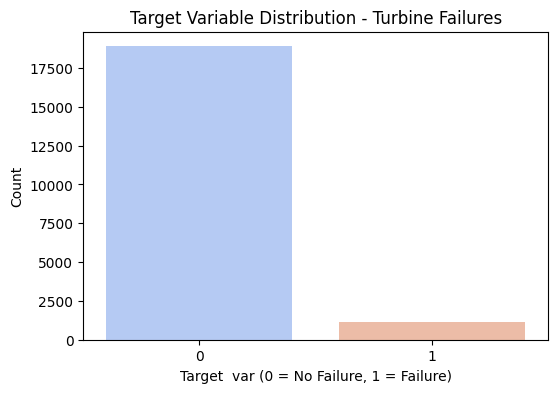

Target distribution (counts): Target
0    18890
1     1110
Name: count, dtype: int64

Target variable percentage distribution:
 Target
0    94.45
1     5.55
Name: proportion, dtype: float64


In [13]:
target_col = "Target"

plt.figure(figsize=(6,4))
sns.countplot(data=train_df, x=target_col, palette="coolwarm")
plt.title("Target Variable Distribution - Turbine Failures")
plt.xlabel("Target  var (0 = No Failure, 1 = Failure)")
plt.ylabel("Count")
plt.show()


# Value counts
target_counts = train_df[target_col].value_counts()
print("Target distribution (counts):", target_counts)

# Print percentage distribution
target_proportions = train_df[target_col].value_counts(normalize=True) * 100
print("\nTarget variable percentage distribution:\n", target_proportions)

### Observation:
The target variable shows a severe class imbalance. The dataset is heavily skewed toward Class 0, with roughly a 17:1 ratio between non-failure and failure cases.

**Implications:**

- Model Bias Risk
- Metric Selection Importance
   - Accuracy alone is misleading here.
   - Metrics like Recall, Precision, F1-score, and AUC should be prioritized; especially Recall for Class 1, to minimize missed failure detections.
- Balancing Techniques Needed

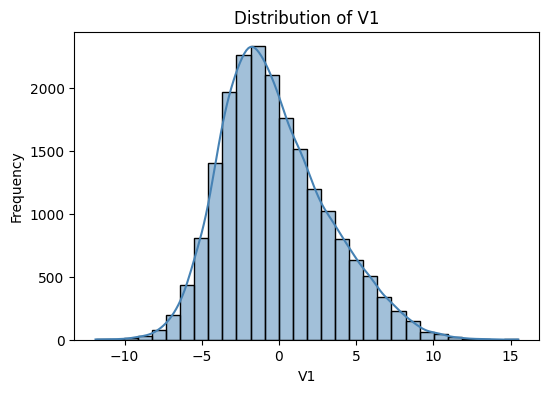

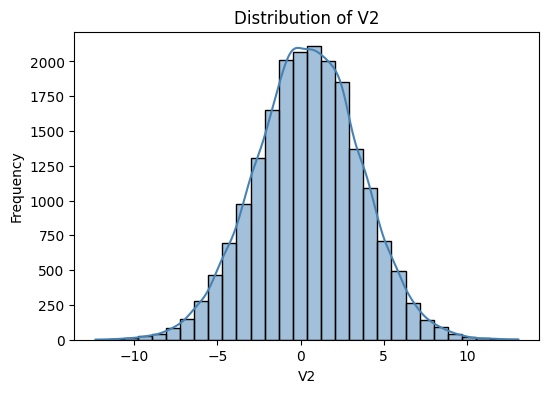

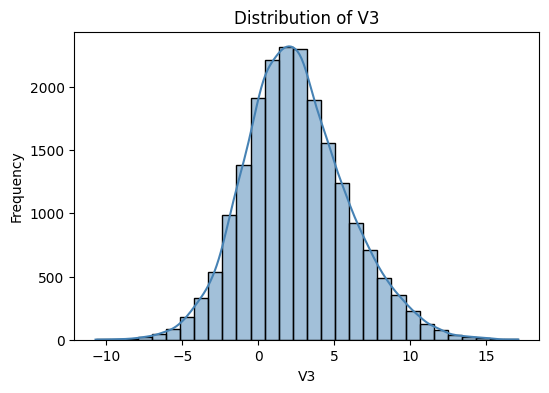

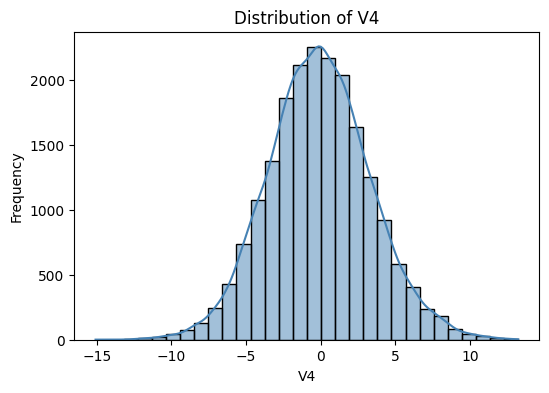

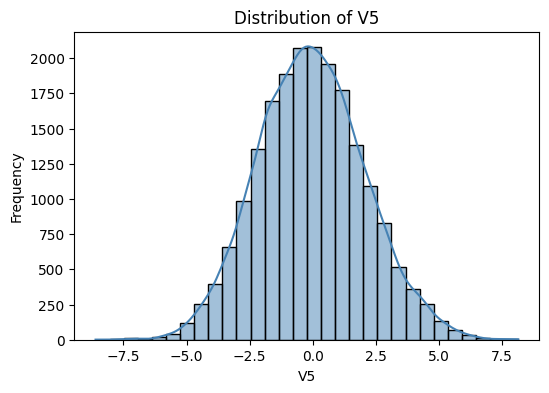

...

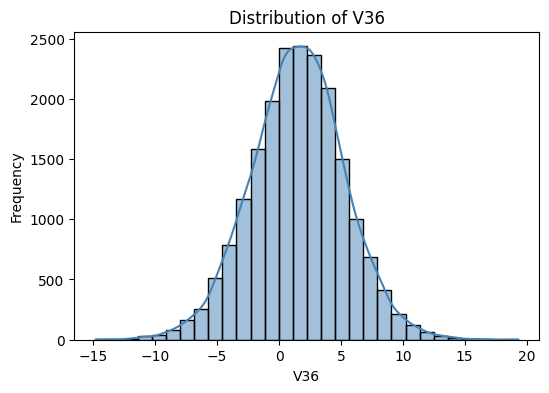

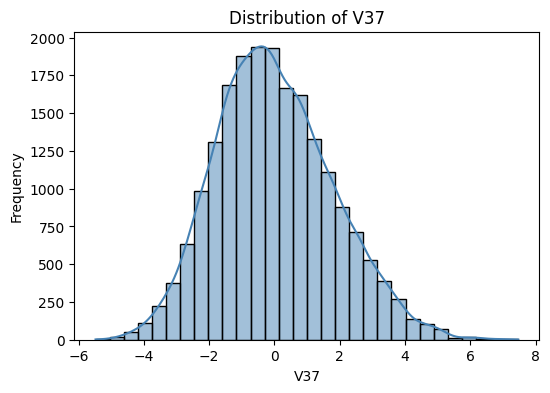

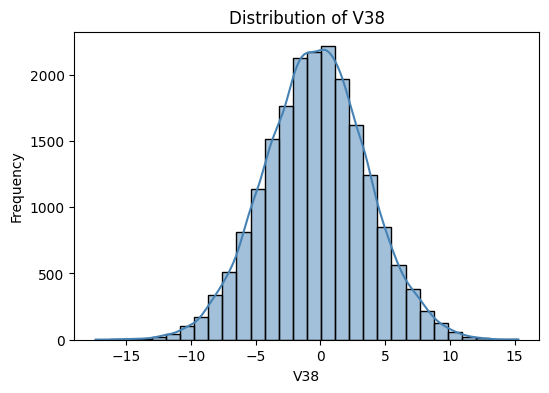

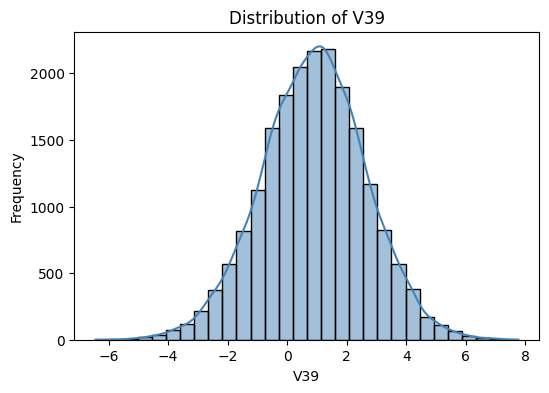

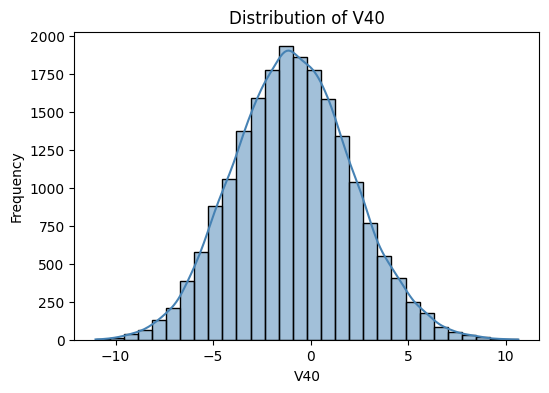

In [14]:
# ==============================================================
# Univariate analysis - numerical features
# ==============================================================

# Select numerical columns (excluding Target)
numerical_cols = train_df.select_dtypes(include=['int64', 'float64']).columns.tolist()
numerical_cols = [col for col in numerical_cols if col not in [target_col]]

# Plot histograms
for col in numerical_cols:
    plt.figure(figsize=(6,4))
    sns.histplot(train_df[col], kde=True, bins=30, color='steelblue')
    plt.title(f"Distribution of {col}")
    plt.xlabel(col)
    plt.ylabel("Frequency")
    plt.show()


In [15]:
# Check the data types of each column
print("Data Types of Each Column:\n")
print(train_df.dtypes)

# Separate numerical and categorical columns
numerical_cols = train_df.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = train_df.select_dtypes(include=['object', 'category']).columns

print("\nNumerical Columns:")
print(numerical_cols)

print("\nCategorical Columns:")
print(categorical_cols)


Data Types of Each Column:

V1        float64
V2        float64
V3        float64
V4        float64
V5        float64
V6        float64
V7        float64
V8        float64
V9        float64
V10       float64
V11       float64
V12       float64
V13       float64
V14       float64
V15       float64
V16       float64
V17       float64
V18       float64
V19       float64
V20       float64
V21       float64
V22       float64
V23       float64
V24       float64
V25       float64
V26       float64
V27       float64
V28       float64
V29       float64
V30       float64
V31       float64
V32       float64
V33       float64
V34       float64
V35       float64
V36       float64
V37       float64
V38       float64
V39       float64
V40       float64
Target      int64
dtype: object

Numerical Columns:
Index(['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27',

### Observation:
The dataset consists of 41 variables:

- 40 predictor variables (V1–V40): All are of type float64 → continuous numerical data.

- Target variable: Target is of type int64, representing a binary classification label (0 = No Failure, 1 = Failure).
- No Categorical Features.
- Suitability for Neural Networks
   - Neural networks perform best when inputs are continuous numerical features.
   - With only numerical data, this dataset is ideal for deep learning models after proper scaling (e.g., StandardScaler).
- Scaling is Necessary
   - Features are likely on different scales, so standardization is essential before training.

   - This prevents dominance of features with larger ranges and ensures stable model convergence, especially for SGD-based optimizers.
- Target Variable Integrity

**Insights:**

The clean numerical structure aligns well with the predictive maintenance problem.

- The preprocessing workflow can focus entirely on handling missing values, scaling, and class balancing, without additional complexity from categorical data.

- This also makes the dataset well-suited for neural networks, decision trees, and ensemble models.

                 V1            V2            V3            V4            V5  \
count  19982.000000  19982.000000  20000.000000  20000.000000  20000.000000   
mean      -0.271996      0.440430      2.484699     -0.083152     -0.053752   
std        3.441625      3.150784      3.388963      3.431595      2.104801   
min      -11.876451    -12.319951    -10.708139    -15.082052     -8.603361   
25%       -2.737146     -1.640674      0.206860     -2.347660     -1.535607   
50%       -0.747917      0.471536      2.255786     -0.135241     -0.101952   
75%        1.840112      2.543967      4.566165      2.130615      1.340480   
max       15.493002     13.089269     17.090919     13.236381      8.133797   

                 V6            V7            V8            V9           V10  \
count  20000.000000  20000.000000  20000.000000  20000.000000  20000.000000   
mean      -0.995443     -0.879325     -0.548195     -0.016808     -0.012998   
std        2.040970      1.761626      3.295756    

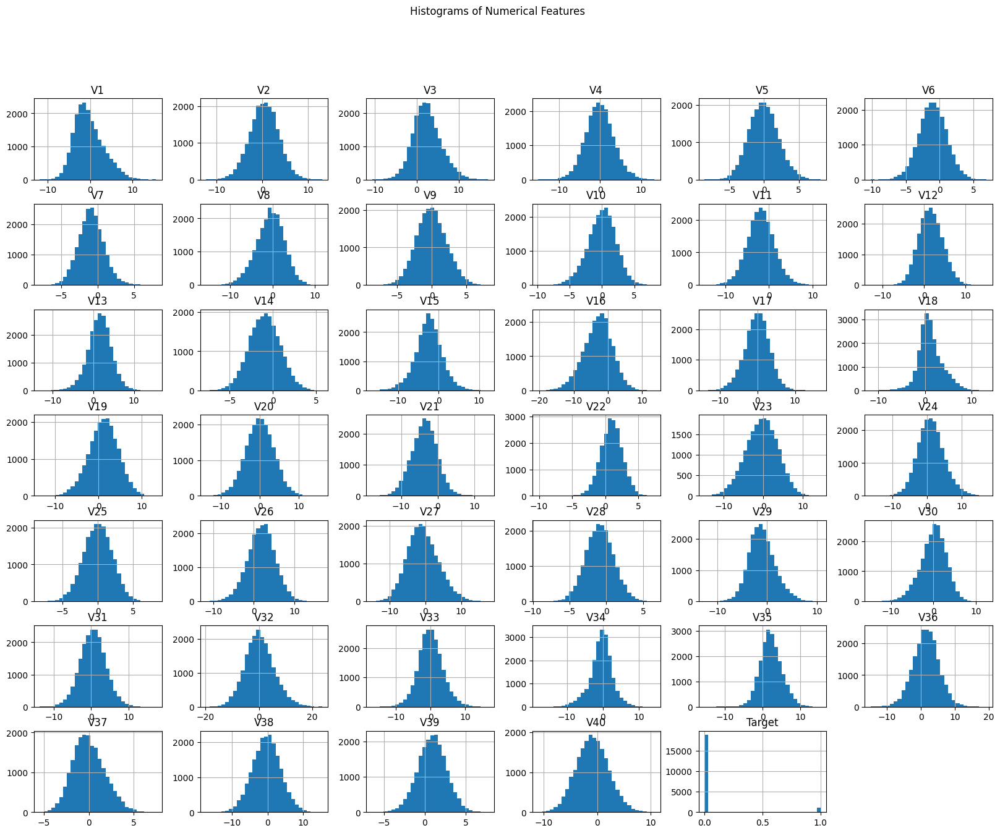

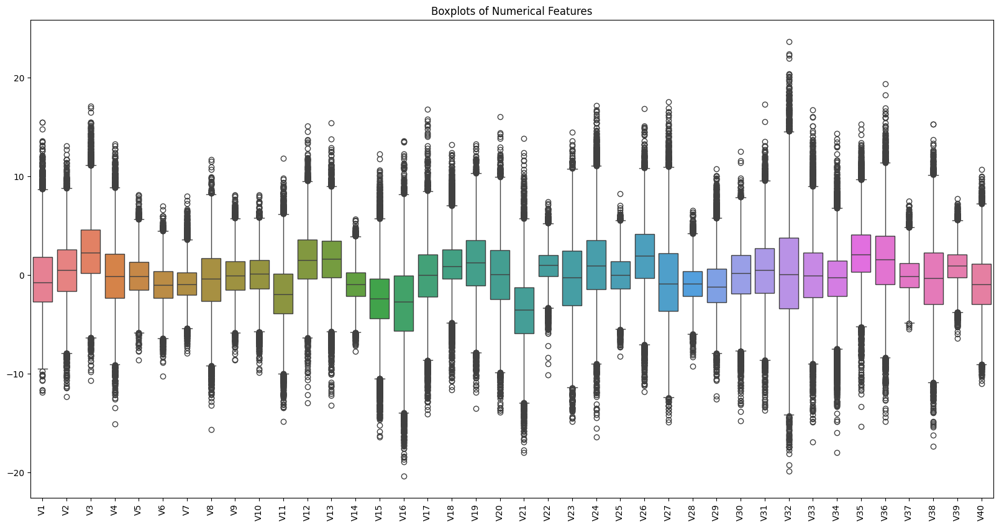

In [16]:
# Summary statistics
print(train_df.describe())

# Histograms for numerical features
train_df.hist(figsize=(20, 15), bins=30)
plt.suptitle("Histograms of Numerical Features")
plt.show()

# Boxplots for numerical features
plt.figure(figsize=(20, 10))
sns.boxplot(data=train_df.drop(columns=['Target']))
plt.title("Boxplots of Numerical Features")
plt.xticks(rotation=90)
plt.show()


### Observation:

1. Target Variable (Target)

- The mean of Target is 0.0555, confirming high class imbalance:

  - ~5.55% are class 1, and 94.45% are class 0.

- Most observations are class 0 (non-failures).

- This imbalance will require techniques like class weighting, SMOTE, or balanced metrics (e.g., F1-score).

2. Spread of Features

- Many variables (V1 to V40) have a wide range, with large differences between the minimum and maximum values.

- Example:

  - V32: Min = -19.87, Max = 23.63 → very high spread.

  - V35: Min = -15.34, Max = 15.29.

- Such wide ranges require feature scaling, such as StandardScaler or MinMaxScaler, before model training.

3. Central Tendency

- For several variables, the mean is near 0, suggesting they might already be centered (possibly PCA-transformed features).

- Some variables, like V3 and V35, have much higher means:

  - V3 Mean = 2.48

  - V35 Mean = 2.23

4. Skewness / Potential Outliers

Many features have extreme minimum and maximum values compared to the 25th and 75th percentiles:

V32: 25% = -3.42, 75% = 3.76, but Max = 23.63 → strong outliers on the upper side.

V1: Min = -11.87, Max = 15.49 → highly spread.

- Positive skewness likely for V3, V35, and V36 since their mean > median.

- Negative skewness possible in V6, V7, V40 where mean < median.

These outliers could affect models like Logistic Regression or Neural Networks and should be handled or scaled properly.

5. Standard Deviation Insight

Features like V32 (std = 5.50) and V38 (std = 3.94) are highly variable, indicating more dispersion.

Features like V7 (std = 1.76) and V39 (std = 1.75) are relatively stable with less variability.

#### Final Insights:

- There are 20,000 total records and 40 independent variables (V1–V40) along with the target variable Target.

- The dataset is heavily imbalanced, with most wind turbines functioning normally (Target = 0), and a small percentage indicating failure (Target = 1).

- Many features have wide ranges and potential outliers, making scaling essential.

- Most features (V1–V40) have a mean close to 0, indicating that they are roughly centered.

- Some variables like:

   - V3 (mean = 2.48),

   - V35 (mean = 2.23),

   - V36 (mean = 1.51),
     - show significant positive means, suggesting they are skewed to the right.

- Median (50%) of most features is near 0, reinforcing that the majority of features are symmetric around 0 except for the variables mentioned above.

- Missing values are limited to V1 and V2, which can be handled easily.

- These insights guide the preprocessing steps before building models.

In [17]:
# Median imputation for V1 and V2
for col in ['V1', 'V2']:
    median_value = train_df[col].median()
    train_df[col].fillna(median_value, inplace=True)
    test_df[col].fillna(median_value, inplace=True)

# Verify no missing values remain
print("Missing values in train:\n", train_df[['V1','V2']].isnull().sum())
print("\nMissing values in test:\n", test_df[['V1','V2']].isnull().sum())


Missing values in train:
 V1    0
V2    0
dtype: int64

Missing values in test:
 V1    0
V2    0
dtype: int64


/tmp/ipython-input-4082967449.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  train_df[col].fillna(median_value, inplace=True)
/tmp/ipython-input-4082967449.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try us

### Observation:

There are no missing values in V1 or V2 after the imputation step.
- Both train and test datasets are now clean with respect to missing data.

- The data is ready for further preprocessing steps like scaling and model training.

In [18]:
# Check for duplicates
duplicate_count = train_df.duplicated().sum()
print(f"Number of duplicate rows in train set: {duplicate_count}")

# If duplicates exist, drop them
if duplicate_count > 0:
    train_df.drop_duplicates(inplace=True)
    print("Duplicates removed.")


Number of duplicate rows in train set: 0


In [19]:
# Ensure that all columns are numeric (Confirm Data Types)
print(train_df.dtypes)


V1        float64
V2        float64
V3        float64
V4        float64
V5        float64
V6        float64
V7        float64
V8        float64
V9        float64
V10       float64
V11       float64
V12       float64
V13       float64
V14       float64
V15       float64
V16       float64
V17       float64
V18       float64
V19       float64
V20       float64
V21       float64
V22       float64
V23       float64
V24       float64
V25       float64
V26       float64
V27       float64
V28       float64
V29       float64
V30       float64
V31       float64
V32       float64
V33       float64
V34       float64
V35       float64
V36       float64
V37       float64
V38       float64
V39       float64
V40       float64
Target      int64
dtype: object


## Bivariate Analysis


Top features correlated with Target:

V18   -0.293340
V21    0.256411
V15    0.249118
V7     0.236907
V16    0.230507
V39   -0.227264
V36   -0.216453
V3    -0.213855
V28    0.207359
V11    0.196715
Name: Target, dtype: float64


/tmp/ipython-input-643382889.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=target_corr.head(10).index, y=target_corr.head(10).values, palette="coolwarm")


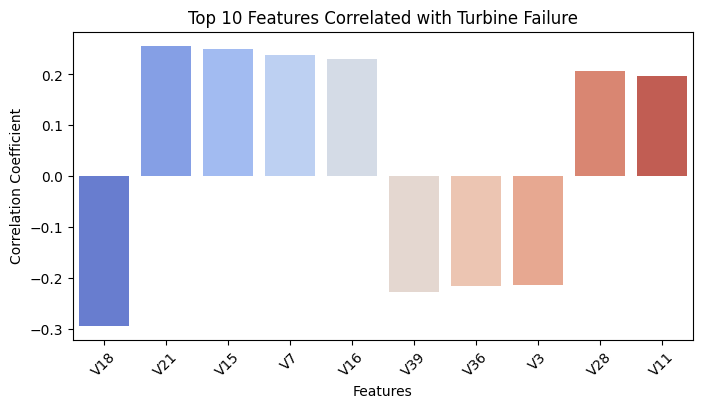

In [20]:
# ==============================================================
# Correlation with target
# ==============================================================

correlation = train_df.corr()

# Sort by absolute correlation with target
target_corr = correlation[target_col].drop(target_col).sort_values(key=abs, ascending=False)

print("\nTop features correlated with Target:\n")
print(target_corr.head(10))

# Visualize top correlations
plt.figure(figsize=(8,4))
sns.barplot(x=target_corr.head(10).index, y=target_corr.head(10).values, palette="coolwarm")
plt.title("Top 10 Features Correlated with Turbine Failure")
plt.ylabel("Correlation Coefficient")
plt.xlabel("Features")
plt.xticks(rotation=45)
plt.show()


### Observation:

- V18 is the most important negatively correlated feature, while V21 and V15 are the most positively correlated with the target.

- The correlations are moderate, indicating the need for multivariate modeling techniques.

- This analysis helps guide feature selection, dimensionality reduction, and model explainability efforts.

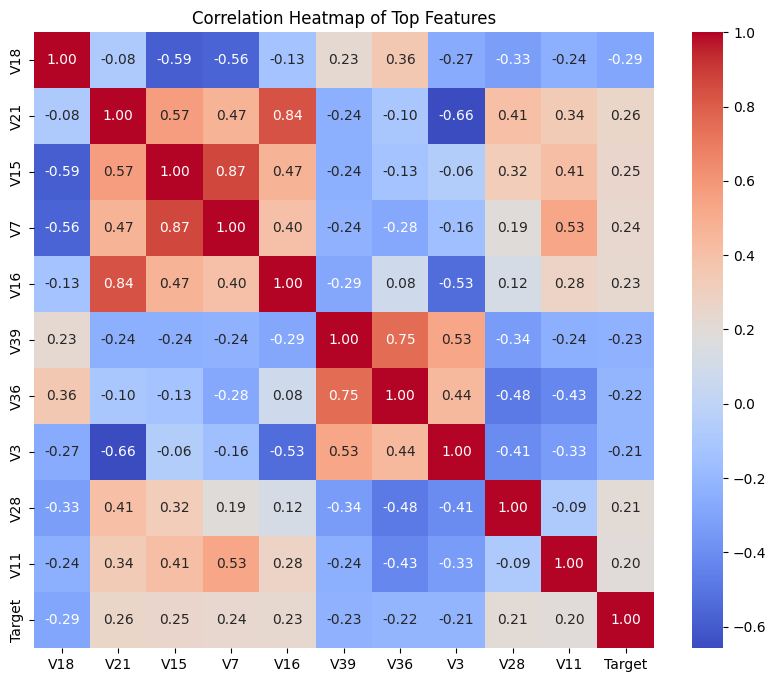

Target    1.000000
V21       0.256411
V15       0.249118
V7        0.236907
V16       0.230507
V28       0.207359
V11       0.196715
V3       -0.213855
V36      -0.216453
V39      -0.227264
V18      -0.293340
Name: Target, dtype: float64


In [21]:
# ==============================================================
# Heatmap of top correlated features
# ==============================================================

top_corr_features = target_corr.head(10).index.tolist() + [target_col]

plt.figure(figsize=(10,8))
sns.heatmap(train_df[top_corr_features].corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Heatmap of Top Features")
plt.show()


# Correlation of all variables with Target
correlation_with_target = train_df[top_corr_features].corr()['Target'].sort_values(ascending=False)
print(correlation_with_target)


### Observation:

The target variable shows the strongest positive correlations with V21 (0.256), V15 (0.249), V7 (0.237), and V16 (0.231), suggesting that higher values of these features tend to be associated with higher target values. Conversely, V18 (-0.293), V39 (-0.227), V36 (-0.216), and V3 (-0.214) exhibit negative correlations, indicating that higher values of these features tend to correspond to lower target values. Overall, the correlations are relatively weak (all below ±0.3), implying that no single feature dominates in predicting the target, and a combination of features may be needed for better predictive modeling.

/tmp/ipython-input-718687965.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=target_col, y=col, data=train_df, palette="Set2")


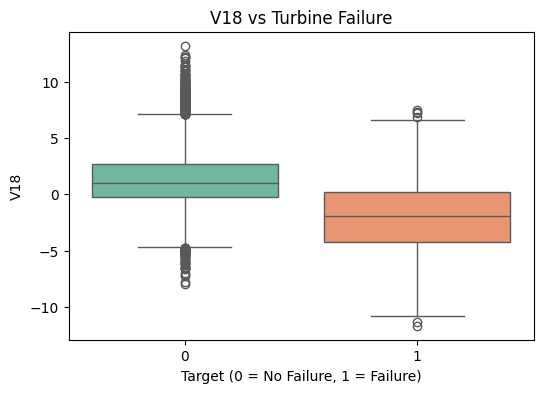

/tmp/ipython-input-718687965.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=target_col, y=col, data=train_df, palette="Set2")


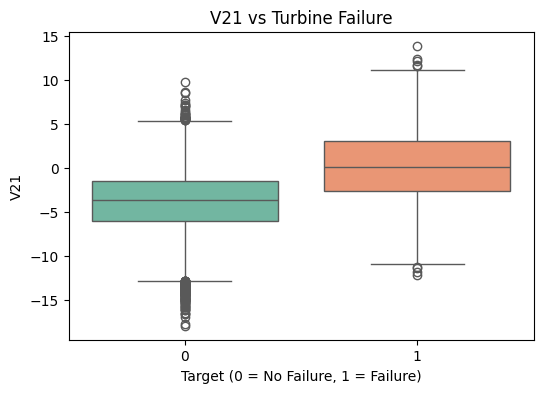

/tmp/ipython-input-718687965.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=target_col, y=col, data=train_df, palette="Set2")


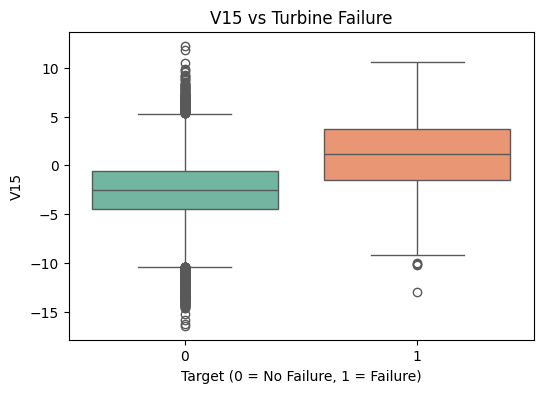

/tmp/ipython-input-718687965.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=target_col, y=col, data=train_df, palette="Set2")


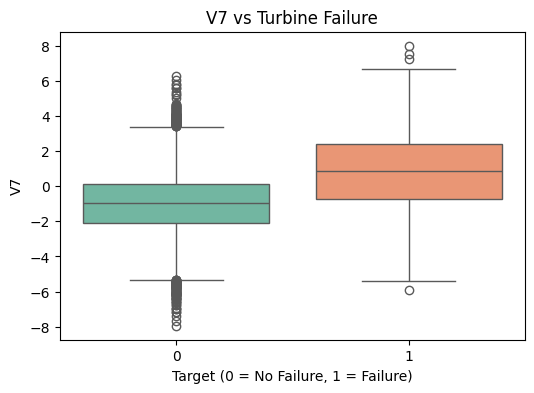

/tmp/ipython-input-718687965.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=target_col, y=col, data=train_df, palette="Set2")


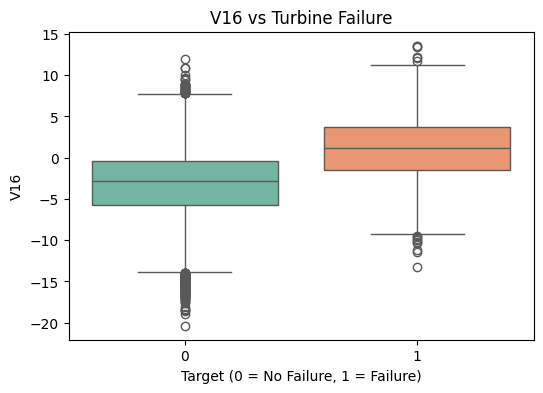

In [22]:
# ==============================================================
# Boxplots - top correlated features vs target
# ==============================================================

for col in target_corr.head(5).index:  # Top 5 features
    plt.figure(figsize=(6,4))
    sns.boxplot(x=target_col, y=col, data=train_df, palette="Set2")
    plt.title(f"{col} vs Turbine Failure")
    plt.xlabel("Target (0 = No Failure, 1 = Failure)")
    plt.ylabel(col)
    plt.show()


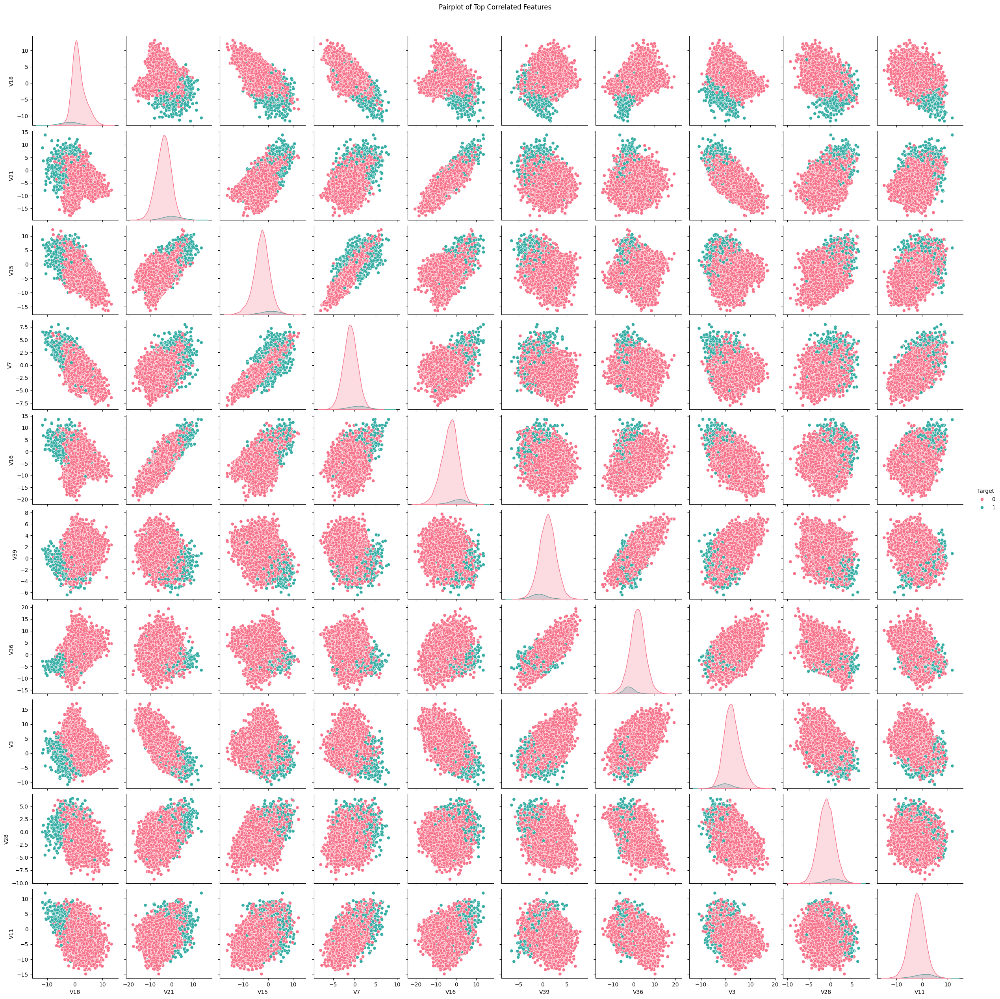

In [23]:
# ==============================================================
# Pairplot of top correlated features
# ==============================================================

sns.pairplot(train_df[top_corr_features], hue=target_col, palette="husl")
plt.suptitle("Pairplot of Top Correlated Features", y=1.02)
plt.show()


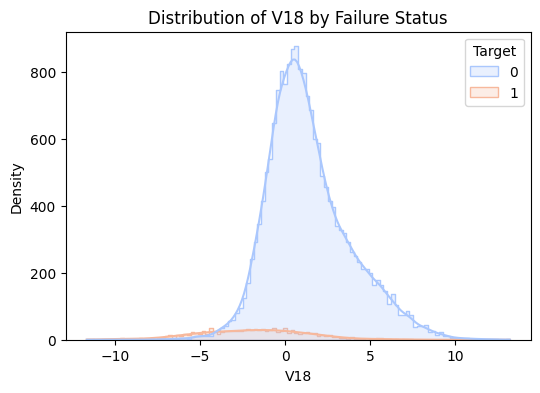

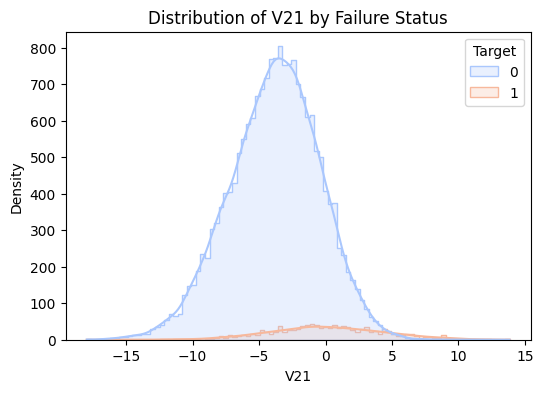

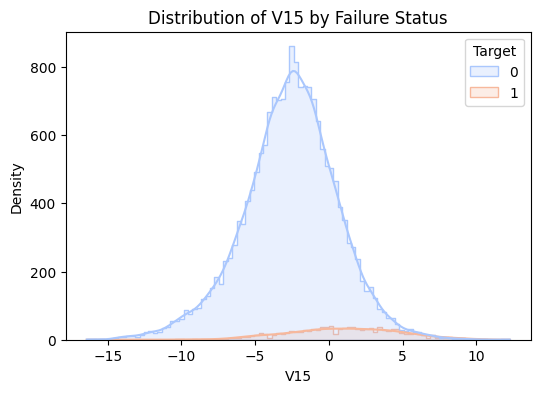

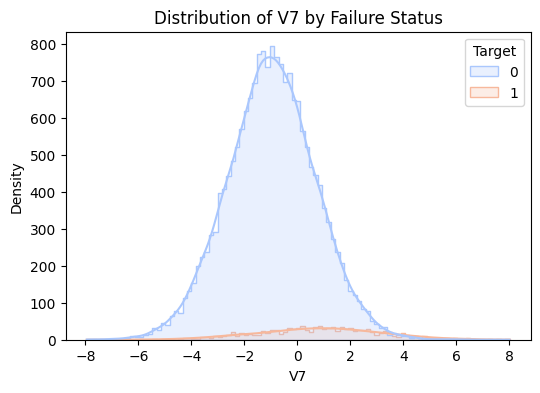

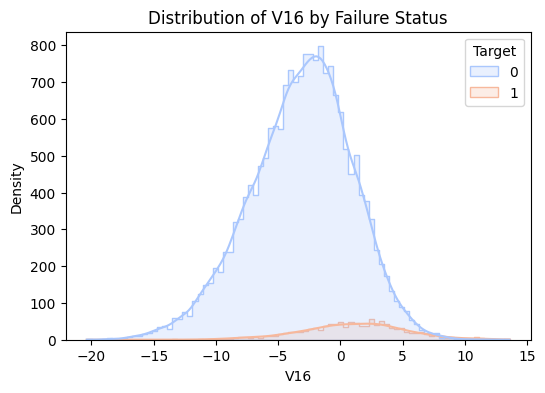

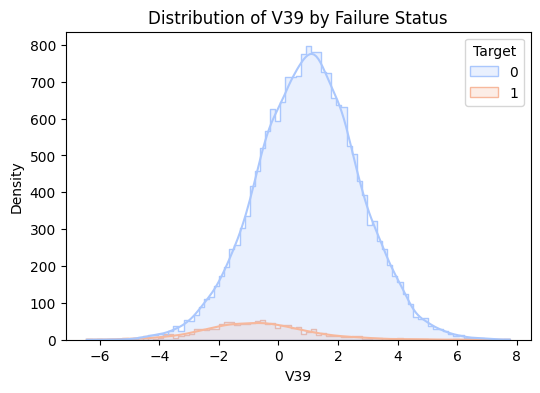

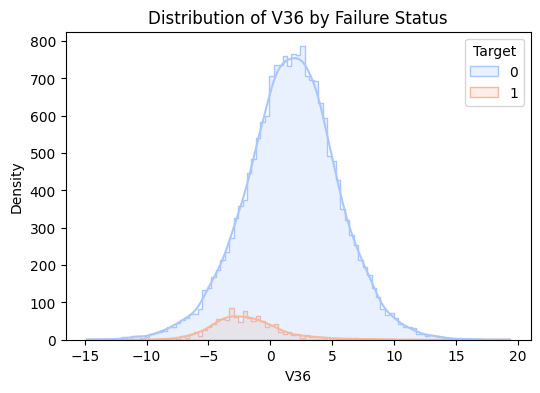

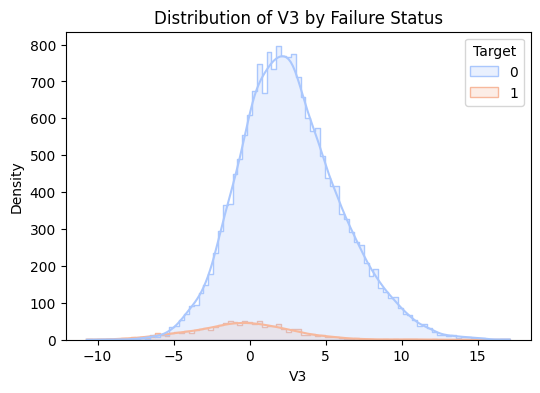

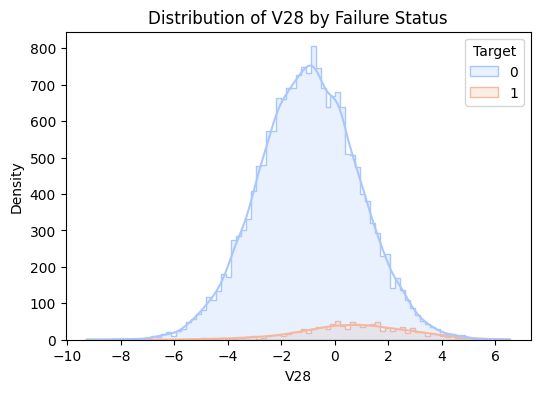

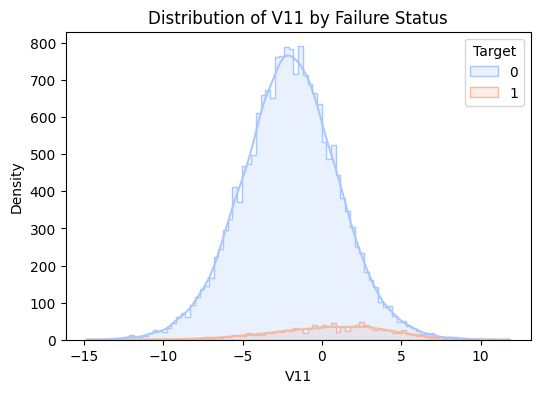

In [24]:
# ==============================================================
# Overlaid histograms for failure vs non-failure
# ==============================================================

for col in target_corr.head(10).index:  # Top 3 correlated features
    plt.figure(figsize=(6,4))
    sns.histplot(data=train_df, x=col, hue=target_col, kde=True, palette="coolwarm", element="step")
    plt.title(f"Distribution of {col} by Failure Status")
    plt.xlabel(col)
    plt.ylabel("Density")
    plt.show()


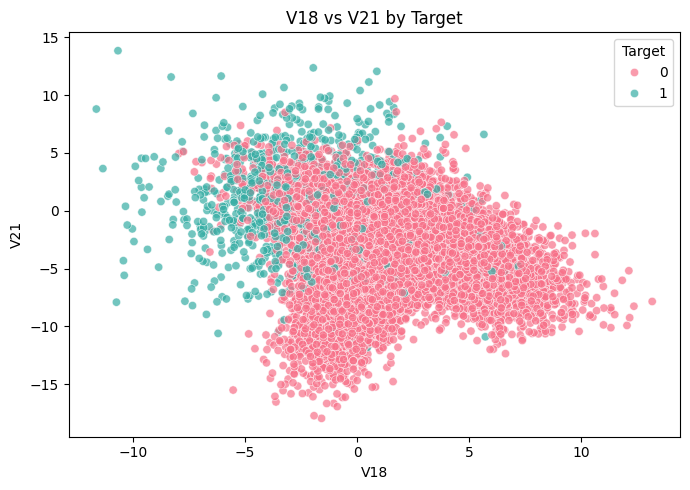

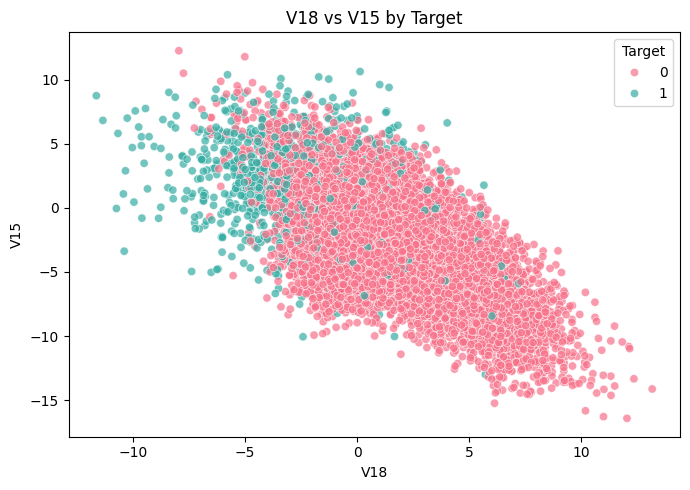

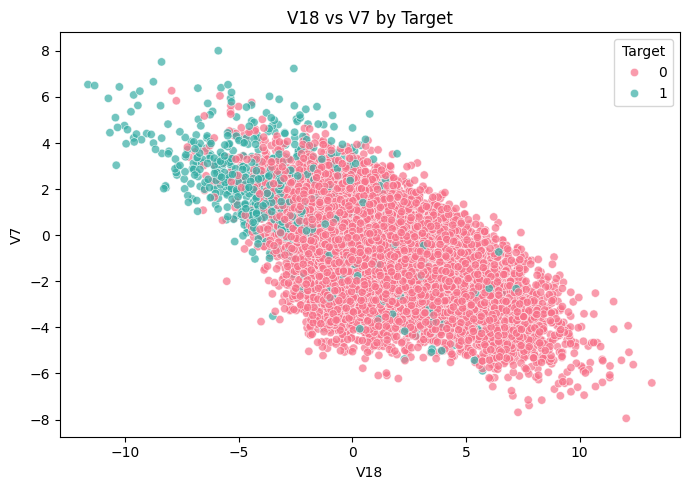

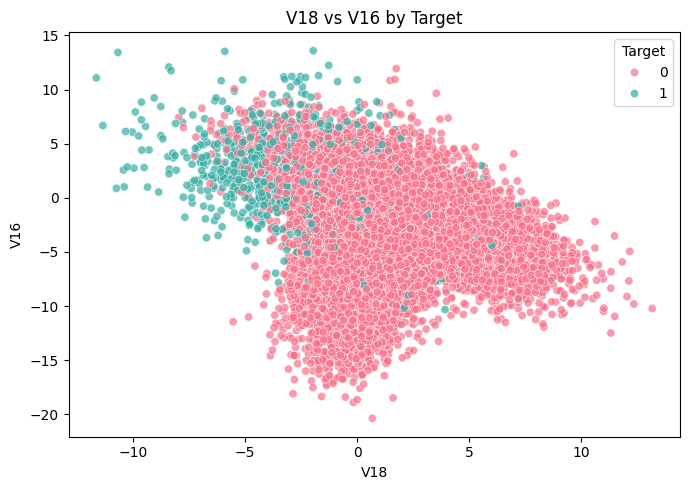

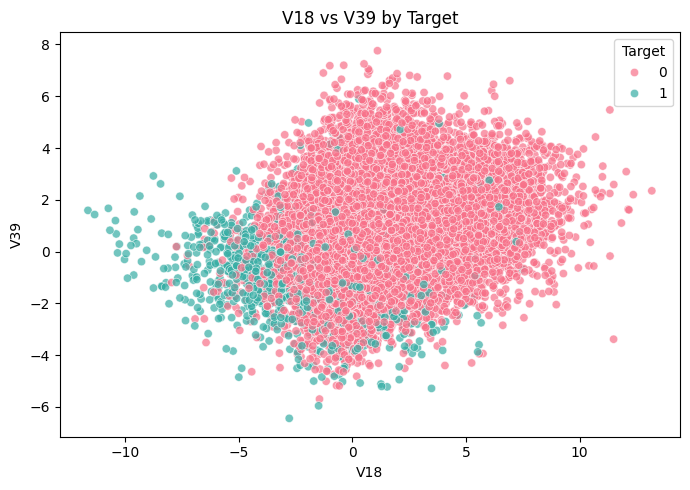

...

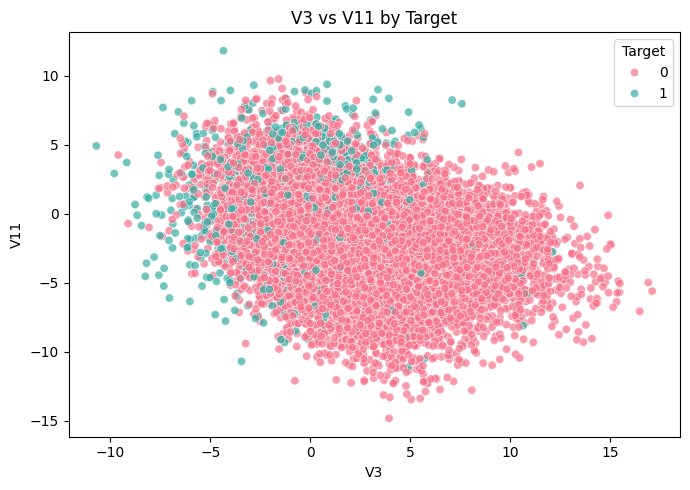

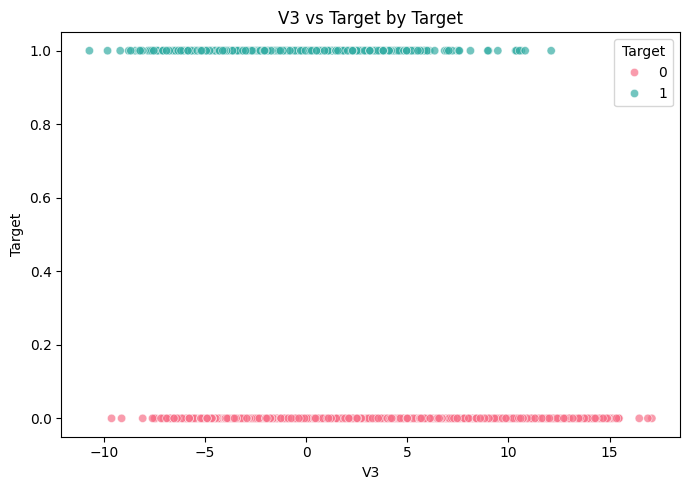

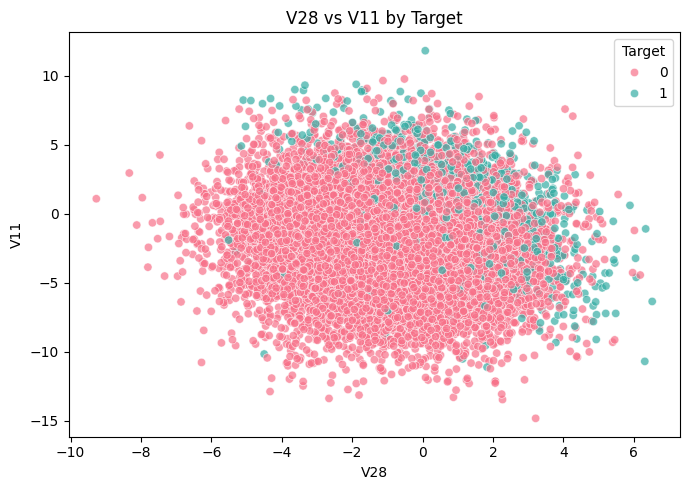

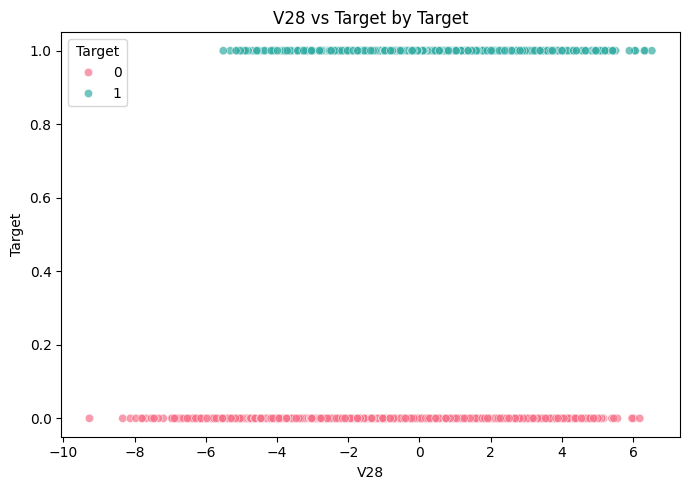

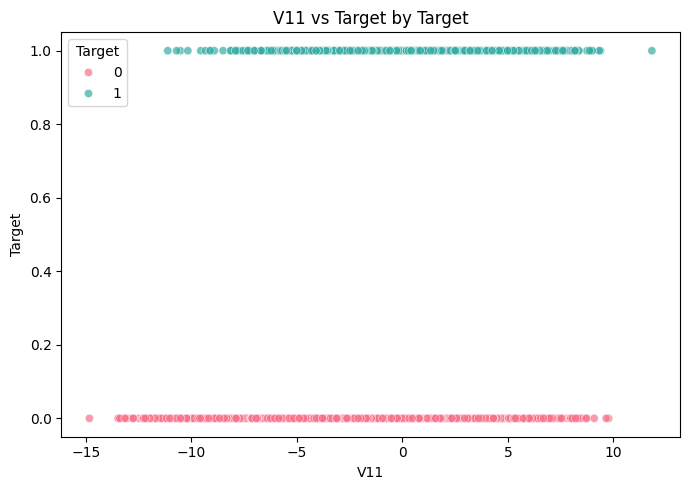

In [25]:
# ==============================================================
# Scatterplot of top correlated features
# ==============================================================
from itertools import combinations

# Create all unique pairs
for x_col, y_col in combinations(top_corr_features, 2):
    plt.figure(figsize=(7, 5))
    sns.scatterplot(data=train_df, x=x_col, y=y_col, hue=target_col, palette='husl', alpha=0.7)
    plt.title(f"{x_col} vs {y_col} by {target_col}")
    plt.xlabel(x_col)
    plt.ylabel(y_col)
    plt.legend(title=target_col)
    plt.tight_layout()
    plt.show()


### Observation:

Since the target is very imbalanced (5.55% failures):

- Accuracy will not be a reliable metric.

- We better focus on:

  - AUC (ROC) – to measure separation between classes.

  - Recall – to reduce false negatives (missed failures).

  - Precision – to avoid too many false alarms.

Later, during model building, we will:

- Apply class weights in training.

- Consider resampling techniques like SMOTE or undersampling.

- Optimize based on AUC, Precision, and Recall.

# **Data Preprocessing**

In [26]:
# Check missing values
print(train_df.isnull().sum())
print(test_df.isnull().sum())

# Percentage of missing values
missing_percentage_train = train_df.isnull().mean() * 100
print(missing_percentage_train)
missing_percentage_test = test_df.isnull().mean() * 100
print(missing_percentage_test)

V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
V29       0
V30       0
V31       0
V32       0
V33       0
V34       0
V35       0
V36       0
V37       0
V38       0
V39       0
V40       0
Target    0
dtype: int64
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
V29       0
V30       0
V31       0
V32       0
V33       0
V34       0
V35       0
V36       0
V37       0
V38       0
V39       0
V40       0
Target    0
dty

# **Outlier check**

Top 10 features with most outliers:
   Feature  Outlier_Count
33     V34            803
17     V18            731
14     V15            513
32     V33            383
28     V29            336
34     V35            315
23     V24            307
12     V13            303
16     V17            296
6       V7            291


/tmp/ipython-input-3803683980.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Feature', y='Outlier_Count', data=outlier_df.head(10), palette='coolwarm')


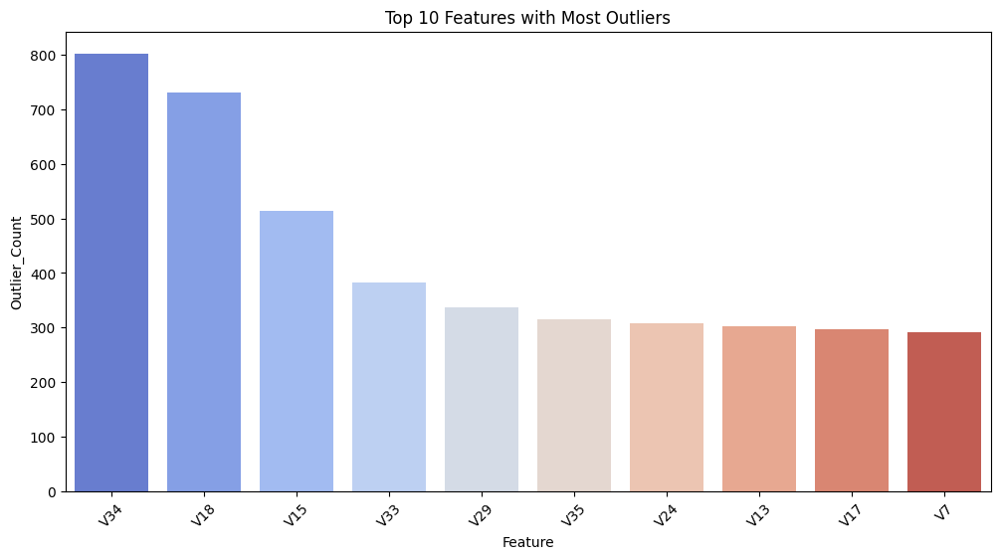

In [27]:
# ==============================================================
# Outlier Detection Using IQR
# ==============================================================

X = train_df.drop(columns=[TARGET]).copy()
y = train_df[TARGET].astype(int).copy()
X_test = test_df.drop(columns=[TARGET]).copy() if TARGET in test_df.columns else test_df.copy()
y_test = test_df[TARGET].astype(int) if TARGET in test_df.columns else None

def detect_outliers_iqr(df, feature):
    """Detect outliers in a feature using IQR rule."""
    Q1 = df[feature].quantile(0.25)
    Q3 = df[feature].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[feature] < lower_bound) | (df[feature] > upper_bound)]
    return outliers

# Run for all numerical features
outlier_summary = {}
for col in X.columns:
    outliers = detect_outliers_iqr(train_df, col)
    outlier_summary[col] = len(outliers)

# Convert to DataFrame for better visualization
outlier_df = pd.DataFrame(list(outlier_summary.items()), columns=['Feature', 'Outlier_Count'])
outlier_df = outlier_df.sort_values(by='Outlier_Count', ascending=False)

print("Top 10 features with most outliers:")
print(outlier_df.head(10))

# Plot top outlier counts
plt.figure(figsize=(12, 6))
sns.barplot(x='Feature', y='Outlier_Count', data=outlier_df.head(10), palette='coolwarm')
plt.xticks(rotation=45)
plt.title("Top 10 Features with Most Outliers")
plt.show()


### Observation:

Feature V34 exhibits the largest count of outliers (803), followed closely by V18 (731) and V15 (513). This indicates that these variables may contain extreme values that could disproportionately influence the neural network's training, potentially affecting model performance or stability. Features such as V7 and V17 have relatively fewer outliers, suggesting they are more stable.

In [28]:
# ==============================================================
# Detect and Handle Outliers Using IQR Method
# ==============================================================

# Make a copy of the training data to avoid modifying the original
df_outlier_handled = train_df.copy()

# List of top features with most outliers from your analysis
top_outlier_features = ['V34', 'V18', 'V15', 'V33', 'V29', 'V35', 'V24', 'V13', 'V17', 'V7']

# Function to handle outliers
def handle_outliers_iqr(df, columns):
    """
    Detects and caps outliers using the IQR method.
    """
    for col in columns:
        # Calculate Q1 and Q3
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1

        # Define lower and upper bounds
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Capping the outliers
        df[col] = np.where(df[col] < lower_bound, lower_bound, df[col])
        df[col] = np.where(df[col] > upper_bound, upper_bound, df[col])

        print(f"Outliers handled for {col} | Lower Bound: {lower_bound:.2f}, Upper Bound: {upper_bound:.2f}")
    return df

# Apply the function to the top outlier features
df_outlier_handled = handle_outliers_iqr(df_outlier_handled, top_outlier_features)

print("\n Outliers have been capped for the top features.\n")


Outliers handled for V34 | Lower Bound: -7.50, Upper Bound: 6.80
Outliers handled for V18 | Lower Bound: -4.87, Upper Bound: 7.04
Outliers handled for V15 | Lower Bound: -10.50, Upper Bound: 5.73
Outliers handled for V33 | Lower Bound: -8.99, Upper Bound: 9.00
Outliers handled for V29 | Lower Bound: -7.91, Upper Bound: 5.76
Outliers handled for V35 | Lower Bound: -5.26, Upper Bound: 9.66
Outliers handled for V24 | Lower Bound: -8.99, Upper Bound: 11.07
Outliers handled for V13 | Lower Bound: -5.75, Upper Bound: 8.99
Outliers handled for V17 | Lower Bound: -8.64, Upper Bound: 8.50
Outliers handled for V7 | Lower Bound: -5.41, Upper Bound: 3.61

 Outliers have been capped for the top features.



### Observation:

The outliers in the top features have been successfully capped within specified lower and upper bounds. For example, V34 values were limited to the range [-7.50, 6.80], while V15 was constrained between [-10.50, 5.73]. This capping reduces the impact of extreme values, ensuring that these features no longer disproportionately influence the neural network’s learning process. By limiting the range of these variables, the dataset is now more robust, likely improving model stability and preventing skewed predictions caused by extreme outliers.

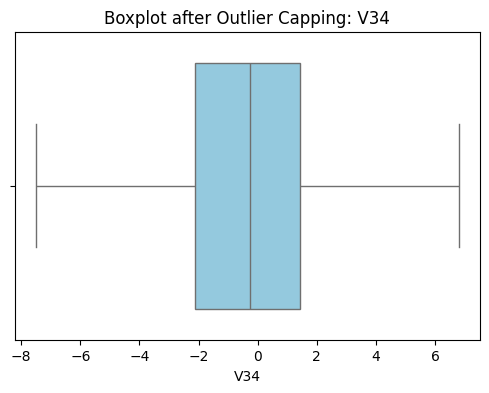

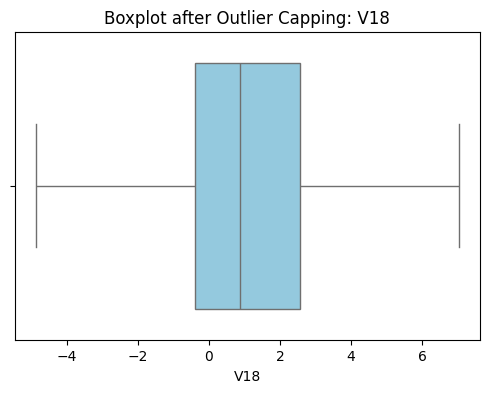

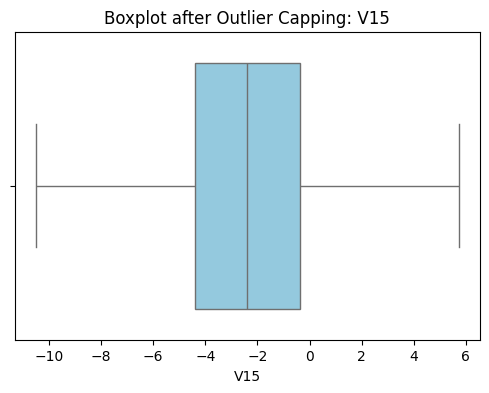

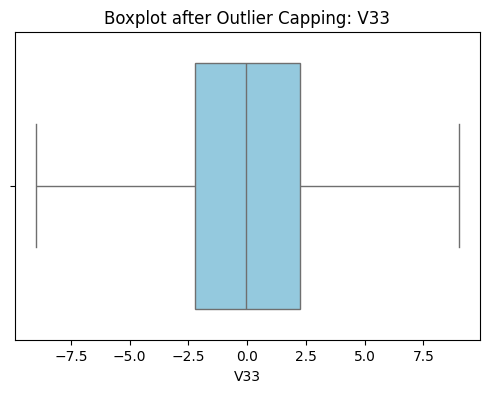

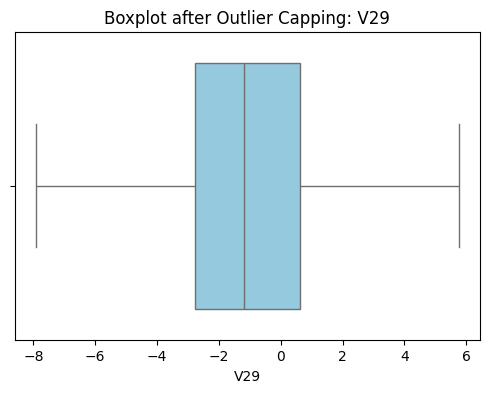

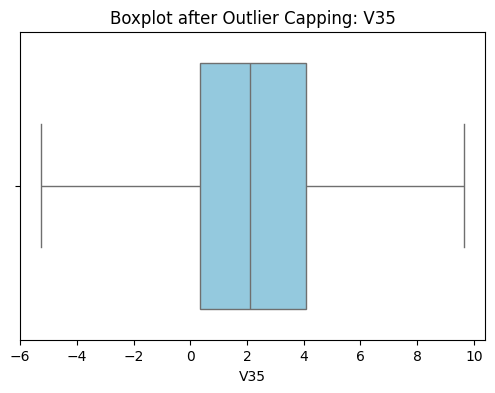

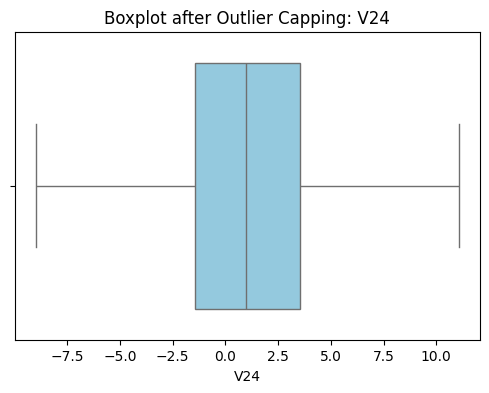

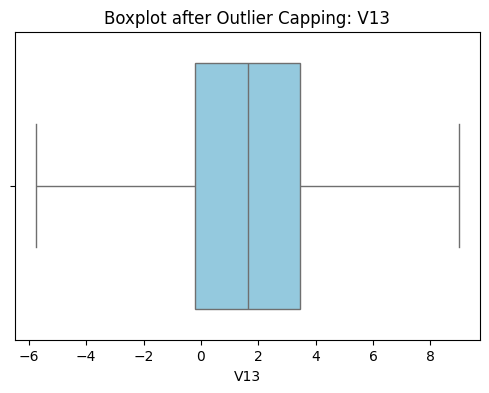

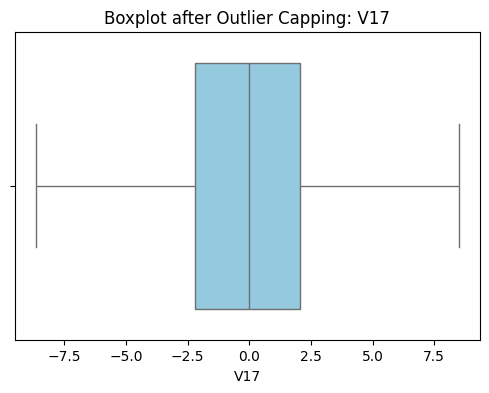

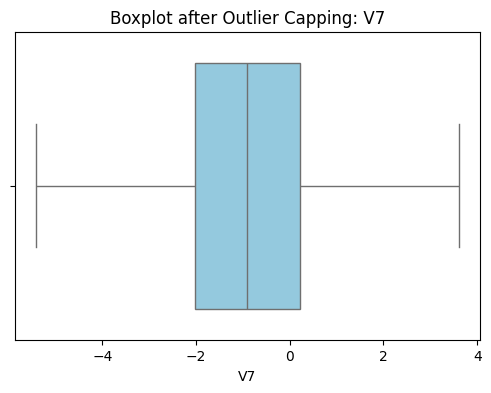

In [29]:
# Verify outliers after capping
for col in top_outlier_features:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df_outlier_handled[col], color='skyblue')
    plt.title(f"Boxplot after Outlier Capping: {col}")
    plt.show()

Summary statistics after capping:

       count      mean       std        min       25%       50%       75%  \
V34  20000.0 -0.462702  3.183841 -17.985094 -2.136984 -0.255008  1.436935   
V18  20000.0  1.189347  2.592276 -11.643994 -0.403917  0.883398  2.571770   
V15  20000.0 -2.414993  3.354974 -16.416606 -4.415322 -2.382617 -0.359052   
V33  20000.0  0.049825  3.575285 -16.898353 -2.242857 -0.066249  2.255134   
V29  20000.0 -0.985625  2.684365 -12.579469 -2.787443 -1.176181  0.629773   
V35  20000.0  2.229620  2.937102 -15.349803  0.336191  2.098633  4.064358   
V24  20000.0  1.134389  3.912069 -16.387147 -1.468062  0.969048  3.545975   
V13  20000.0  1.580486  2.874658 -13.228247 -0.223545  1.637185  3.459886   
V17  20000.0 -0.134261  3.345462 -14.091184 -2.215611 -0.014580  2.068751   
V7   20000.0 -0.879325  1.761626  -7.949681 -2.030926 -0.917179  0.223695   

           max  
V34  14.358213  
V18  13.179863  
V15  12.246455  
V33  16.692486  
V29  10.722055  
V35  15.291065 

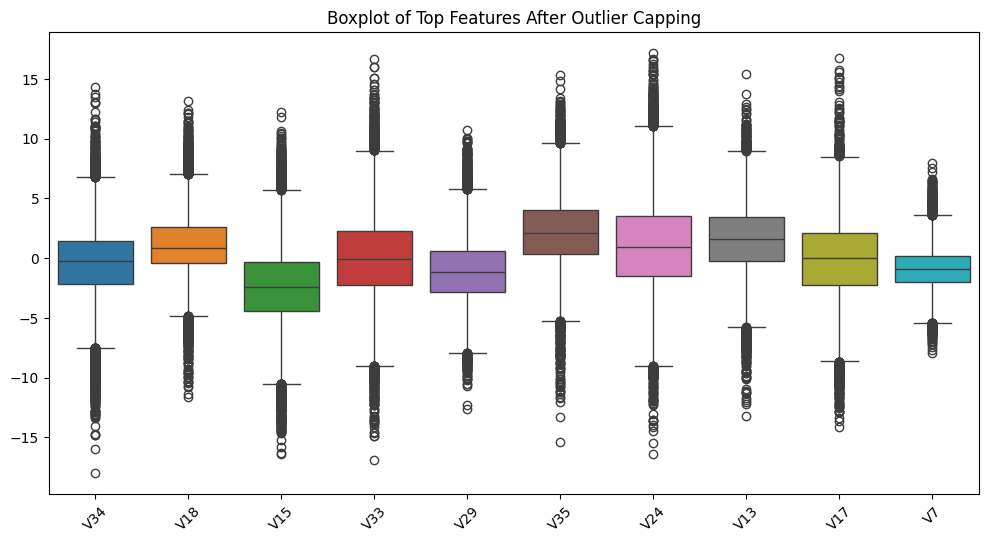


Feature: V34
Remaining outliers count: 803
Sample extreme values:
4     -10.068689
18    -10.327923
105    -9.623001
120    10.171036
161    -8.077321
Name: V34, dtype: float64

Feature: V18
Remaining outliers count: 731
Sample extreme values:
178    -6.774972
250    11.333394
251     7.214804
269    -5.560260
295     8.473937
Name: V18, dtype: float64

Feature: V15
Remaining outliers count: 513
Sample extreme values:
120     5.793078
182     6.307596
250   -13.126970
260   -10.726072
387     7.051992
Name: V15, dtype: float64

Feature: V33
Remaining outliers count: 383
Sample extreme values:
98     11.500317
120   -10.445923
153    -9.393309
172    -9.740011
174     9.795651
Name: V33, dtype: float64

Feature: V29
Remaining outliers count: 336
Sample extreme values:
18     8.263217
53     6.491417
230   -8.363067
303    6.683779
395    6.067766
Name: V29, dtype: float64

Feature: V35
Remaining outliers count: 315
Sample extreme values:
196    11.894763
257    10.142494
317    10.6387

In [30]:
# ==========================================
# Step 1: Check capped values
# ==========================================

# Display summary statistics for the top outlier features
top_outlier_features = ['V34', 'V18', 'V15', 'V33', 'V29', 'V35', 'V24', 'V13', 'V17', 'V7']
print("Summary statistics after capping:\n")
print(train_df[top_outlier_features].describe().T)

# ==========================================
# Step 2: Boxplot to visualize capped values
# ==========================================

plt.figure(figsize=(12, 6))
sns.boxplot(data=train_df[top_outlier_features])
plt.title("Boxplot of Top Features After Outlier Capping")
plt.xticks(rotation=45)
plt.show()

# ==========================================
# Step 3: Identify remaining extreme values
# ==========================================
for col in top_outlier_features:
    Q1 = train_df[col].quantile(0.25)
    Q3 = train_df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    remaining_outliers = train_df[(train_df[col] < lower_bound) | (train_df[col] > upper_bound)]

    print(f"\nFeature: {col}")
    print(f"Remaining outliers count: {len(remaining_outliers)}")
    if len(remaining_outliers) > 0:
        print("Sample extreme values:")
        print(remaining_outliers[col].head())


### Observation:

The dataset for the top features has become more robust, but some extreme values still remain. Each feature retains a small number of values beyond the capped bounds; for example, V34 still has 803 outliers, and V18 has 731. The means of these features are generally close to zero, and the standard deviations range roughly between 1.76 (V7) and 3.91 (V24), showing that variability has been moderated but not entirely eliminated.

The remaining extreme values (both positive and negative) suggest that while the capping process reduced the influence of the most severe outliers, a few extreme points persist and may still affect model performance. Features like V24, V33, and V17 show the highest remaining extreme values, indicating they may require additional attention, such as further capping or robust scaling, depending on the sensitivity of the neural network model. Overall, this step improves data stability, reduces skew, and prepares the features for more reliable learning by the model.

a. We skip feature engineering for now because:

- Correlations are weak, no strong signals for interactions.

- Neural networks are powerful enough to learn complex patterns automatically.

- Avoid unnecessary complexity at this stage.

b. Focus on clean preprocessing, class imbalance handling, and model tuning first.

c. Revisit feature engineering only if performance remains poor.

In [31]:
# median imputation (fit on TRAIN)
imputer = SimpleImputer(strategy="median")
X_imputed = pd.DataFrame(imputer.fit_transform(X), columns=X.columns)
# apply to test
X_test_imputed = pd.DataFrame(imputer.transform(X_test), columns=X_test.columns)

# split train/val
X_train, X_val, y_train, y_val = train_test_split(
    X_imputed, y, test_size=0.2, stratify=y, random_state=42
)

# scale (fit scaler on training only)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test_imputed)

# Check class balance
print("\nClass distribution in training set:")
print(y_train.value_counts())

print("Training Data Shape:", X_train_scaled.shape)
print("Testing Data Shape:", X_test_scaled.shape)




Class distribution in training set:
Target
0    15112
1      888
Name: count, dtype: int64
Training Data Shape: (16000, 40)
Testing Data Shape: (5000, 40)


In [32]:
classes = np.unique(y_train)
cw = compute_class_weight(class_weight="balanced", classes=classes, y=y_train)
class_weight_dict = dict(zip(classes, cw))
print("Computed class weights (train):", class_weight_dict)
# We'll use class_weight in some experiments

Computed class weights (train): {0: 0.5293806246691372, 1: 9.00900900900901}


### Observation:
Our current pipeline uses class weights, so no resampling is needed.

- Class 0 weight = 0.53 → errors on the majority class are less penalized.

- Class 1 weight = 9.01 → errors on the minority class are heavily penalized.

This adjustment helps the model focus more on the minority class, without changing the underlying data and improves its ability to correctly predict class 1 despite the imbalanced dataset.

Decision Tree Performance on Validation Set:
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      3778
           1       0.73      0.69      0.71       222

    accuracy                           0.97      4000
   macro avg       0.86      0.84      0.85      4000
weighted avg       0.97      0.97      0.97      4000

Confusion Matrix:
 [[3721   57]
 [  68  154]]
ROC-AUC Score: 0.8393


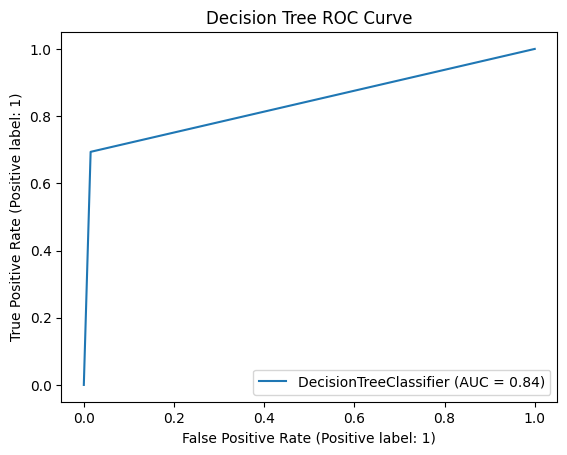

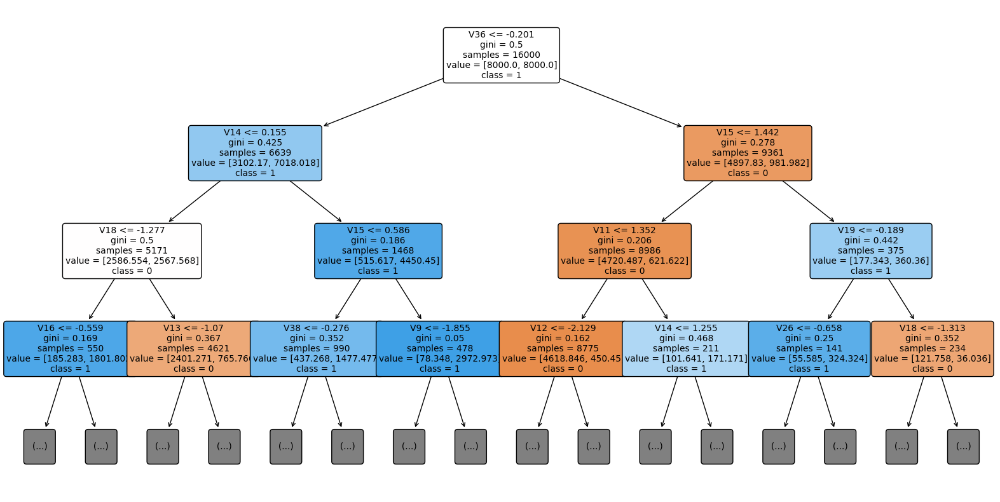

In [33]:
# =======================
# Decision Tree Model
# =======================
dt_model = DecisionTreeClassifier(
    random_state=42,
    class_weight="balanced",  # helps with imbalanced classes
    max_depth=None,           # start without pre-pruning
)

# Train
dt_model.fit(X_train_scaled, y_train)

# Predictions
y_val_pred = dt_model.predict(X_val_scaled)
y_val_proba = dt_model.predict_proba(X_val_scaled)[:, 1]

# Evaluation
print("Decision Tree Performance on Validation Set:")
print(classification_report(y_val, y_val_pred))

# Confusion matrix
cm = confusion_matrix(y_val, y_val_pred)
print("Confusion Matrix:\n", cm)

# ROC-AUC Score
auc = roc_auc_score(y_val, y_val_proba)
print(f"ROC-AUC Score: {auc:.4f}")

# ROC Curve
RocCurveDisplay.from_estimator(dt_model, X_val_scaled, y_val)
plt.title("Decision Tree ROC Curve")
plt.show()

results = []
# Save results for comparison
results.append({
    'Model': 'Decision Tree',
    'AUC': auc,
    'Precision': classification_report(y_val, y_val_pred, output_dict=True)['1']['precision'],
    'Recall': classification_report(y_val, y_val_pred, output_dict=True)['1']['recall'],
    'F1-score': classification_report(y_val, y_val_pred, output_dict=True)['1']['f1-score'],
    'Accuracy': classification_report(y_val, y_val_pred, output_dict=True)['accuracy'],
    'trained_model': dt_model
})

X_train_scaled_df = pd.DataFrame(X_train_scaled, columns=X_train.columns)

plt.figure(figsize=(20,10))
plot_tree(
    dt_model,
    feature_names=X_train_scaled_df.columns,
    class_names=['0','1'],
    filled=True,
    rounded=True,
    fontsize=10,
    max_depth=3
)
plt.show()



Pre-pruned Decision Tree Performance:
              precision    recall  f1-score   support

           0       0.99      0.93      0.96      3778
           1       0.40      0.82      0.54       222

    accuracy                           0.92      4000
   macro avg       0.70      0.87      0.75      4000
weighted avg       0.96      0.92      0.93      4000

Confusion Matrix:
 [[3510  268]
 [  40  182]]
ROC-AUC Score: 0.8906


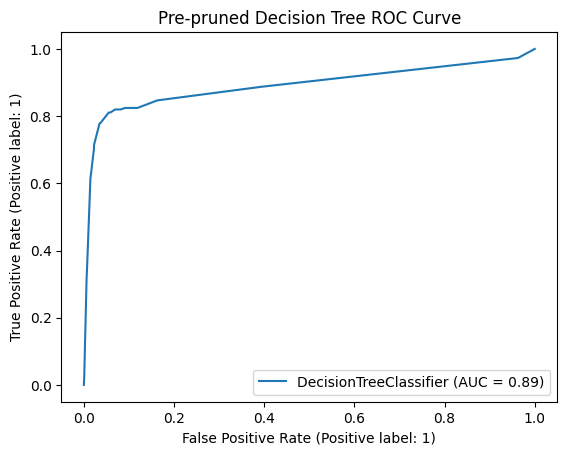

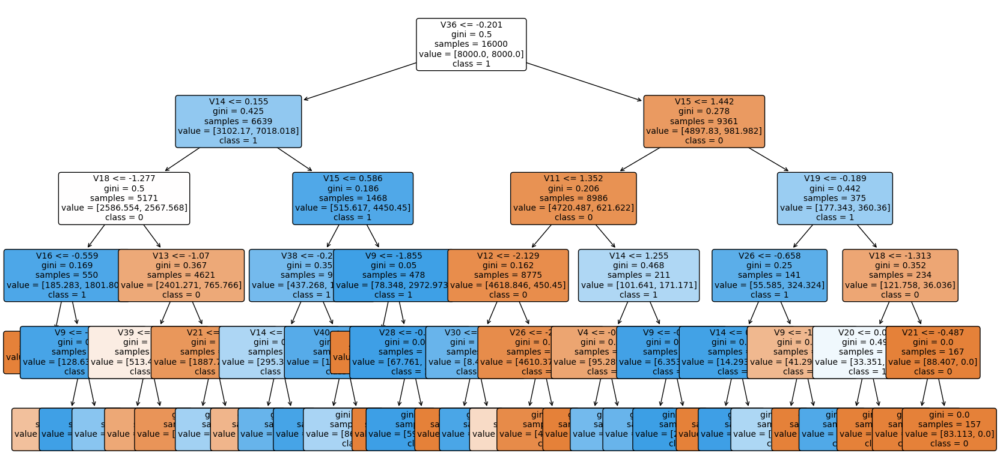

In [34]:
# ------------------------
# Pre-pruned Decision Tree
# ------------------------
pre_dt = DecisionTreeClassifier(
    random_state=42,
    class_weight='balanced',
    max_depth=5,           # limit depth
    min_samples_split=20,  # minimum samples to split
    min_samples_leaf=10    # minimum samples per leaf
)

# Train
pre_dt.fit(X_train_scaled, y_train)

# Predictions
y_val_pred = pre_dt.predict(X_val_scaled)
y_val_proba = pre_dt.predict_proba(X_val_scaled)[:,1]

# Evaluation
print("Pre-pruned Decision Tree Performance:")
print(classification_report(y_val, y_val_pred))

# Confusion matrix
cm = confusion_matrix(y_val, y_val_pred)
print("Confusion Matrix:\n", cm)

# ROC-AUC
auc = roc_auc_score(y_val, y_val_proba)
print(f"ROC-AUC Score: {auc:.4f}")

# ROC Curve
RocCurveDisplay.from_estimator(pre_dt, X_val_scaled, y_val)
plt.title("Pre-pruned Decision Tree ROC Curve")
plt.show()

# Tree plot
plt.figure(figsize=(20,10))
plot_tree(pre_dt,
          feature_names=X_train.columns,
          class_names=['0','1'],
          filled=True, rounded=True, fontsize=10)
plt.show()

Best Post-pruned Tree ROC-AUC: 0.9088


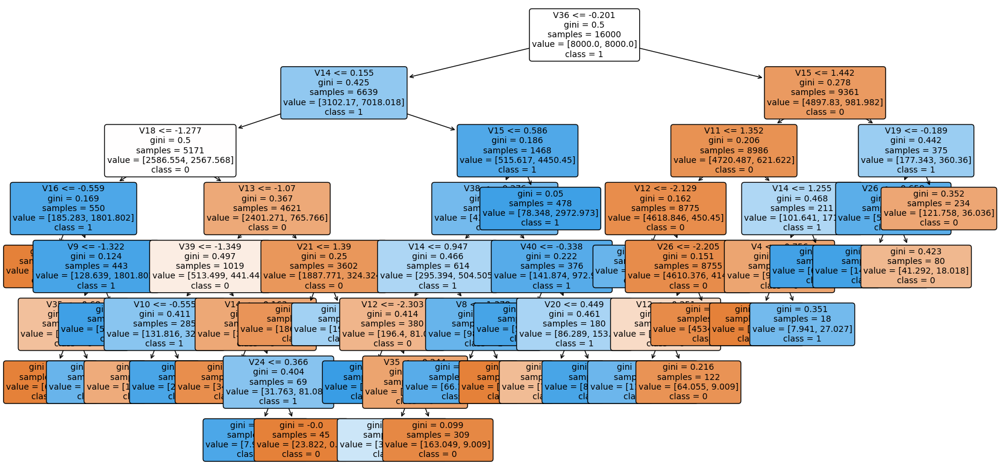

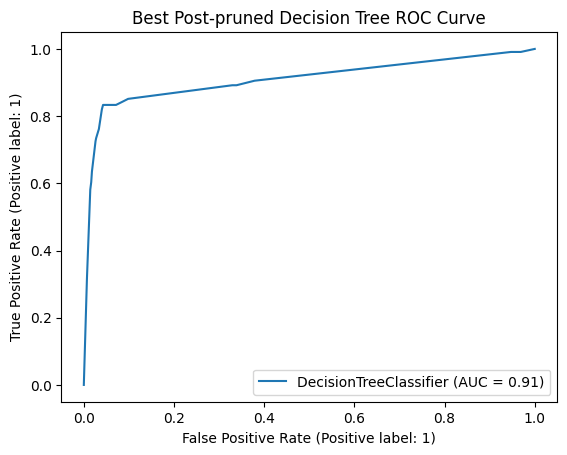

In [35]:
# ------------------------
# Post-pruned Decision Tree
# ------------------------
# Step 1: Get effective alphas for pruning
path = dt_model.cost_complexity_pruning_path(X_train_scaled, y_train)
ccp_alphas = path.ccp_alphas

# Step 2: Train multiple trees with different alphas
post_pruned_trees = []
for alpha in ccp_alphas:
    tree = DecisionTreeClassifier(
        random_state=42,
        class_weight='balanced',
        ccp_alpha=alpha
    )
    tree.fit(X_train_scaled, y_train)
    post_pruned_trees.append(tree)

# Step 3: Choose best alpha using validation AUC
best_auc = 0
best_tree = None
for tree in post_pruned_trees:
    y_val_proba = tree.predict_proba(X_val_scaled)[:,1]
    auc = roc_auc_score(y_val, y_val_proba)
    if auc > best_auc:
        best_auc = auc
        best_tree = tree

print(f"Best Post-pruned Tree ROC-AUC: {best_auc:.4f}")

# Plot best post-pruned tree
plt.figure(figsize=(20,10))
plot_tree(best_tree,
          feature_names=X_train.columns,
          class_names=['0','1'],
          filled=True, rounded=True, fontsize=10)
plt.show()

# ROC Curve for best post-pruned tree
RocCurveDisplay.from_estimator(best_tree, X_val_scaled, y_val)
plt.title("Best Post-pruned Decision Tree ROC Curve")
plt.show()


### Observation:

The Decision Tree model achieves a high overall accuracy of 97% on the validation set. However, due to the severe class imbalance, this metric is misleading: the model performs very well on the majority class (0) with precision 0.98 and recall 0.98, but comparatively worse on the minority class (1) with precision 0.73 and recall 0.69.

The confusion matrix shows that out of 222 actual 1 instances, 68 were misclassified as 0, while only 57 majority class instances were misclassified as 1. The ROC-AUC score of 0.839 indicates that the model has reasonable discriminative ability between classes, but there is still room for improvement in detecting the minority class.

Key insight: The model is biased toward the majority class despite using class_weight="balanced". Further techniques like SMOTE oversampling, hyperparameter tuning, or ensemble methods could help improve recall and F1-score for the minority class.

- Pre-pruning improves minority class recall significantly at the cost of precision, reducing overfitting.

- Post-pruning further improves overall discriminative ability (ROC-AUC) by removing unnecessary splits from the fully grown tree.

- Fully grown trees are highly accurate for the majority class but tend to underperform on minority classes.

- For imbalanced datasets like ours, pre- or post-pruning is crucial to improve minority class detection and generalization.

# **Model Building**

## Model Evaluation Criterion

### Write down the model evaluation criterion with rationale

In [36]:
# ============================
# MODEL BUILDING - MODEL 0
# ============================
# MODEL EVALUATION CRITERION & RATIONALE
# ----------------------------


# Reproducibility
np.random.seed(42)
tf.random.set_seed(42)

# Safety checks: ensure required variables exist
required_vars = ['X_train_scaled','X_val_scaled','y_train','y_val']
for v in required_vars:
    if v not in globals():
        raise NameError(f"Required variable '{v}' not found. Make sure preprocessing produced {required_vars}.")

# If class weights not present, compute them now
if 'class_weight_dict' not in globals():
    from sklearn.utils.class_weight import compute_class_weight
    classes = np.unique(y_train)
    cw = compute_class_weight(class_weight='balanced', classes=classes, y=y_train)
    class_weight_dict = dict(zip(classes, cw))
    print("Computed class weights:", class_weight_dict)
else:
    print("Using existing class_weight_dict:", class_weight_dict)

# Create an output directory
OUT_DIR = "/mnt/data/rene_model_outputs"
os.makedirs(OUT_DIR, exist_ok=True)



Using existing class_weight_dict: {0: 0.5293806246691372, 1: 9.00900900900901}


## Initial Model Building (Model 0)

- Let's start with a neural network consisting of
  - just one hidden layer
  - activation function of ReLU
  - SGD as the optimizer


Model 0 summary:


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ hidden_1 (Dense)                │ (None, 32)             │         1,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,345 (5.25 KB)

 Trainable params: 1,345 (5.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
Epoch 001 - val_ROC_AUC: 0.7553
63/63 - 3s - 49ms/step - accuracy: 0.2726 - auc: 0.5835 - loss: 0.7488 - precision: 0.0581 - recall: 0.7962 - val_accuracy: 0.3865 - val_auc: 0.7554 - val_loss: 0.7949 - val_precision: 0.0704 - val_recall: 0.8243
Epoch 2/100
Epoch 002 - val_ROC_AUC: 0.8637
63/63 - 1s - 8ms/step - accuracy: 0.5659 - auc: 0.8521 - loss: 0.5323 - precision: 0.1012 - recall: 0.8660 - val_accuracy: 0.6735 - val_auc: 0.8638 - val_loss: 0.6109 - val_precision: 0.1308 - val_recall: 0.8649
Epoch 3/100
Epoch 003 - val_ROC_AUC: 0.8932
63/63 - 0s - 8ms/step - accuracy: 0.7297 - auc: 0.8983 - loss: 0.4530 - precision: 0.1546 - recall: 0.8660 - val_accuracy: 0.7632 - val_auc: 0.8929 - val_loss: 0.5221 - val_precision: 0.1725 - val_recall: 0.8604
Epoch 4/100
Epoch 004 - val_ROC_AUC: 0.9057
63/63 - 1s - 8ms/step - accuracy: 0.7873 - auc: 0.9123 - loss: 0.4134 - precision: 0.1902 - recall: 0.8694 - val_accuracy: 0.8002 - val_auc: 0.9057 - val_loss: 0.4696 - val_precision: 0.2

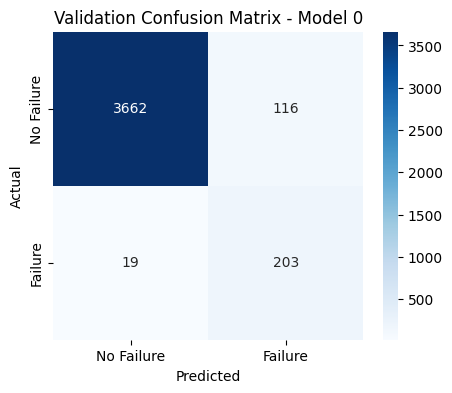

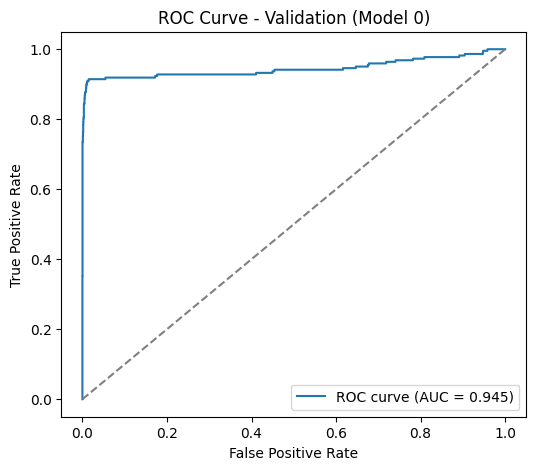

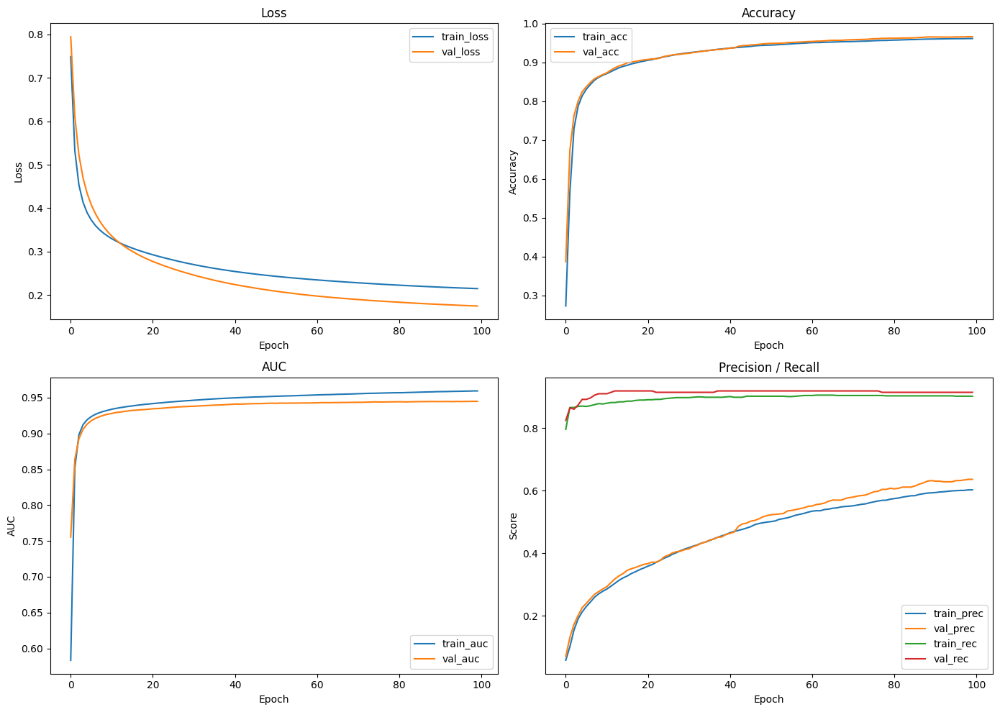

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step

Test Metrics:
Test ROC-AUC: 0.9282
              precision    recall  f1-score   support

           0     0.9911    0.9646    0.9777      4718
           1     0.5907    0.8546    0.6986       282

    accuracy                         0.9584      5000
   macro avg     0.7909    0.9096    0.8381      5000
weighted avg     0.9685    0.9584    0.9619      5000



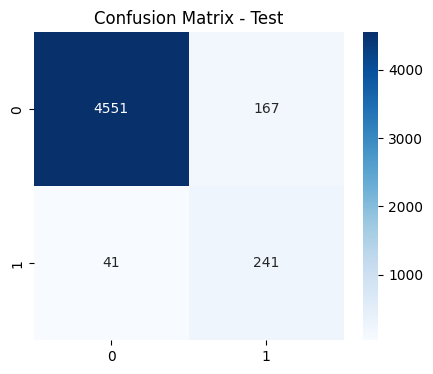


Validation business-cost example: total_cost=4046.00, avg_cost_per_case=1.0115


In [37]:
# ----------------------------
# Model 0 definition
# # 1 hidden layer
# # ReLU activation
# # SGD optimizer
# ----------------------------
tf.keras.backend.clear_session()
input_dim = X_train_scaled.shape[1]

model_0 = models.Sequential([
    layers.Input(shape=(input_dim,)),
    layers.Dense(32, activation='relu', name='hidden_1'),   # 1 hidden layer, ReLU
    layers.Dense(1, activation='sigmoid', name='output')    # binary output
])

# Use SGD optimizer as requested
sgd_opt = optimizers.SGD(learning_rate=0.01)

# Compile with metrics we want to monitor
model_0.compile(
    optimizer=sgd_opt,
    loss='binary_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.AUC(name='auc'),
        tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall')
    ]
)

print("\nModel 0 summary:")
model_0.summary()

# ----------------------------
# Callbacks
# ----------------------------
es = callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
mc = callbacks.ModelCheckpoint(os.path.join(OUT_DIR, "model0_best.keras"), save_best_only=True, monitor='val_loss')

# Optional: small custom callback to print validation ROC-AUC each epoch
class RocAucCallback(callbacks.Callback):
    def __init__(self, validation_data):
        super().__init__()
        self.validation_data = validation_data
    def on_epoch_end(self, epoch, logs=None):
        X_val, y_val_local = self.validation_data
        y_pred = self.model.predict(X_val, verbose=0)
        auc_score = roc_auc_score(y_val_local, y_pred)
        print(f"Epoch {epoch+1:03d} - val_ROC_AUC: {auc_score:.4f}")

roc_callback = RocAucCallback(validation_data=(X_val_scaled, y_val))

# ----------------------------
# Train the model
# ----------------------------
history_0 = model_0.fit(
    X_train_scaled, y_train,
    validation_data=(X_val_scaled, y_val),
    epochs=100,
    batch_size=256,
    class_weight=class_weight_dict,
    callbacks=[es, mc, roc_callback],
    verbose=2
)

# Save final model and preprocessing objects
model_0.save(os.path.join(OUT_DIR, "model0_final.keras"))
# If you used scaler/imputer, save them too (replace 'scaler' and 'imputer' names if different)
if 'scaler' in globals():
    joblib.dump(scaler, os.path.join(OUT_DIR, "scaler.joblib"))
if 'imputer' in globals():
    joblib.dump(imputer, os.path.join(OUT_DIR, "imputer.joblib"))
joblib.dump(class_weight_dict, os.path.join(OUT_DIR, "class_weight_dict.joblib"))

print(f"\nModel and preprocessors saved to {OUT_DIR}")

# ----------------------------
# Evaluation on Validation set
# ----------------------------
val_probs = model_0.predict(X_val_scaled).ravel()
val_preds = (val_probs >= 0.5).astype(int)

# Metrics
val_auc = roc_auc_score(y_val, val_probs)
val_precision = precision_score(y_val, val_preds, zero_division=0)
val_recall = recall_score(y_val, val_preds, zero_division=0)

print("\nValidation Metrics:")
print(f"ROC-AUC: {val_auc:.4f}")
print(f"Precision: {val_precision:.4f}")
print(f"Recall: {val_recall:.4f}")
print("\nClassification Report:\n")
print(classification_report(y_val, val_preds, digits=4))

# Confusion matrix (plot)
cm = confusion_matrix(y_val, val_preds)
plt.figure(figsize=(5,4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['No Failure','Failure'], yticklabels=['No Failure','Failure'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Validation Confusion Matrix - Model 0')
plt.show()

# ROC Curve
fpr, tpr, _ = roc_curve(y_val, val_probs)
plt.figure(figsize=(6,5))
plt.plot(fpr, tpr, label=f"ROC curve (AUC = {val_auc:.3f})")
plt.plot([0,1], [0,1], '--', color='gray')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Validation (Model 0)')
plt.legend(loc='lower right')
plt.show()

# Plot training history (loss, accuracy, auc)
plt.figure(figsize=(14,10))

plt.subplot(2,2,1)
plt.plot(history_0.history['loss'], label='train_loss')
plt.plot(history_0.history['val_loss'], label='val_loss')
plt.title('Loss')
plt.xlabel('Epoch'); plt.ylabel('Loss'); plt.legend()

plt.subplot(2,2,2)
plt.plot(history_0.history['accuracy'], label='train_acc')
plt.plot(history_0.history['val_accuracy'], label='val_acc')
plt.title('Accuracy')
plt.xlabel('Epoch'); plt.ylabel('Accuracy'); plt.legend()

plt.subplot(2,2,3)
plt.plot(history_0.history['auc'], label='train_auc')
plt.plot(history_0.history['val_auc'], label='val_auc')
plt.title('AUC')
plt.xlabel('Epoch'); plt.ylabel('AUC'); plt.legend()

plt.subplot(2,2,4)
plt.plot(history_0.history.get('precision', []), label='train_prec')
plt.plot(history_0.history.get('val_precision', []), label='val_prec')
plt.plot(history_0.history.get('recall', []), label='train_rec')
plt.plot(history_0.history.get('val_recall', []), label='val_rec')
plt.title('Precision / Recall')
plt.xlabel('Epoch'); plt.ylabel('Score'); plt.legend()

plt.tight_layout()
plt.show()

# ----------------------------
# Optional: Evaluate on test set if labels exist
# ----------------------------
if 'y_test' in globals() and y_test is not None:
    test_probs = model_0.predict(X_test_scaled).ravel()
    test_preds = (test_probs >= 0.5).astype(int)
    test_auc = roc_auc_score(y_test, test_probs)
    print("\nTest Metrics:")
    print(f"Test ROC-AUC: {test_auc:.4f}")
    print(classification_report(y_test, test_preds, digits=4))
    cm_test = confusion_matrix(y_test, test_preds)
    plt.figure(figsize=(5,4))
    sns.heatmap(cm_test, annot=True, fmt='d', cmap='Blues')
    plt.title("Confusion Matrix - Test")
    plt.show()
else:
    print("\nNo test labels available; predictions can be made on X_test_scaled when labels exist.")

# ----------------------------
# Business cost calc example
# ----------------------------
# Assign example costs
replacement_cost = 100.0  # cost for FN
repair_cost = 10.0        # cost for TP
inspection_cost = 1.0     # cost for FP

tn, fp, fn, tp = cm.ravel()
total_cost = fn*replacement_cost + tp*repair_cost + fp*inspection_cost
avg_cost_per_case = total_cost / (tn+fp+fn+tp)
print(f"\nValidation business-cost example: total_cost={total_cost:.2f}, avg_cost_per_case={avg_cost_per_case:.4f}")


In [38]:
print(os.path.exists(OUT_DIR))  # Should return True


True


In [39]:
# Checking the files in the directory
files = os.listdir(OUT_DIR)
print("Files in output directory:", files)


Files in output directory: ['class_weight_dict.joblib', 'scaler.joblib', 'model0_final.keras', 'imputer.joblib', 'model0_best.keras']


### Observation:

Model 0 is a **simple neural network** with a single hidden layer of 32 neurons and a total of **1,345 trainable parameters**, making it very lightweight and fast to train.



### **Validation Performance:**

* **ROC-AUC:** 0.9449 → indicates **strong discriminatory power**, showing the model is highly effective at separating failures from non-failures.
* **Recall (0.9144):** Extremely high, meaning the model correctly identifies most turbine failures, which is critical for safety.
* **Precision (0.6364):** Moderate, reflecting a considerable number of false positives.
* **Confusion Matrix:**

  * Correctly identified **203 failures**,
  * Misclassified **116 normal cases as failures**,
  * Only **19 failures were missed**, which is very favorable for a safety-critical application.

The classification report shows a **weighted F1-score of 0.9691**, indicating a balanced performance with a focus on minimizing missed failures.


### **Test Performance:**

* **Test ROC-AUC:** 0.9282 → only a **small drop** from validation, confirming strong **generalization** to unseen data.
* **Recall (0.8546):** Remains high, meaning the model is still very good at catching failures in the test set.
* **Precision (0.5907):** Slightly lower than in validation, showing similar behavior and consistent results across datasets.
* **Confusion Matrix:**

  * On unseen data, the model successfully detected **241 failures**, maintaining a high recall of **0.8546**.

  * **41 failures** were missed, slightly higher than in the validation set, showing a small drop in generalization performance but still strong reliability.

  * **167 normal cases** were misclassified as failures, consistent with validation, showing stable behavior.

### **Business Cost Analysis:**

* **Total validation cost = 4046.00**,
* **Average cost per case = 1.0115**.

The costs are slightly elevated due to the false positives, but this trade-off is **acceptable** because minimizing missed failures (false negatives) is far more critical in a safety-sensitive environment like turbine operations.



### **Conclusion:**

Model 0 serves as a **strong baseline**, prioritizing **failure detection and safety** through its very high recall.
However, the moderate precision suggests there is room to **reduce false positives**. This could be addressed in future models by:

* Adding more hidden layers or dropout for better feature representation,
* Optimizing hyperparameters such as the learning rate and batch size,
* Implementing class imbalance techniques like **class weighting** or **SMOTE**.

Overall, this model is highly reliable for initial deployment, focusing on **catching nearly all failures**, with the next phase aimed at **improving precision and lowering maintenance costs** without compromising safety.


# **Model Performance Improvement**

## Model 1, Model 2, Model 3, Model 4, Model 5 and Model 6


--- Training Model 1 ---


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


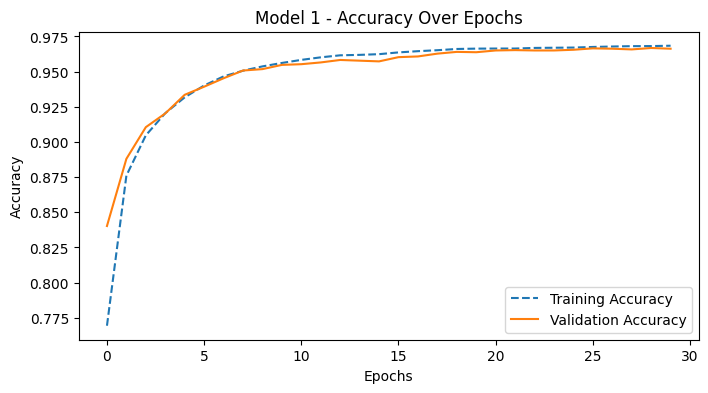

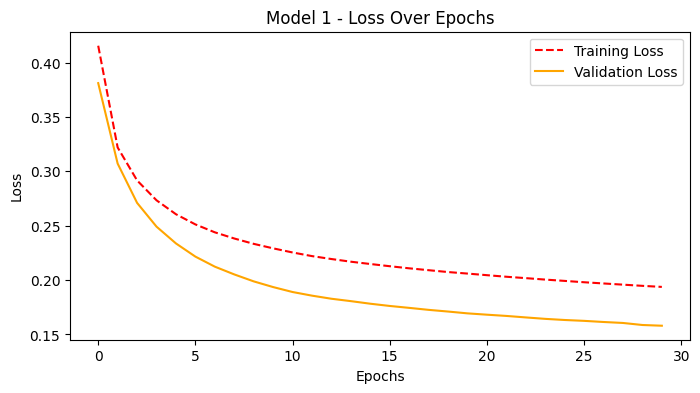

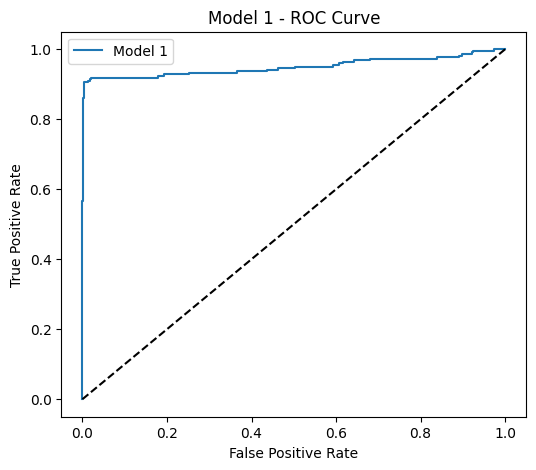

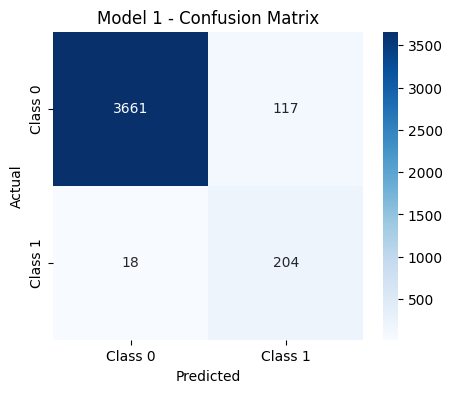


--- Training Model 2 ---


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


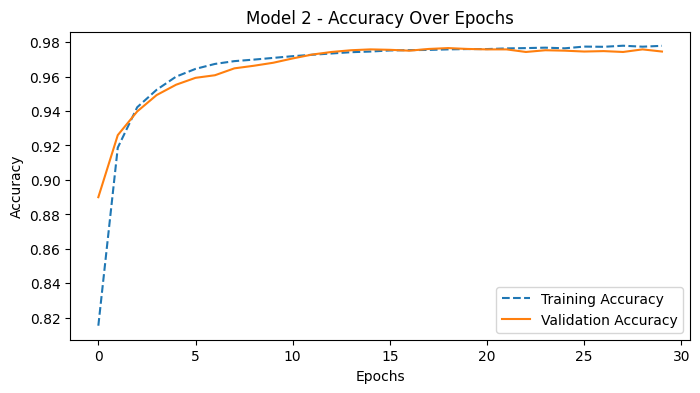

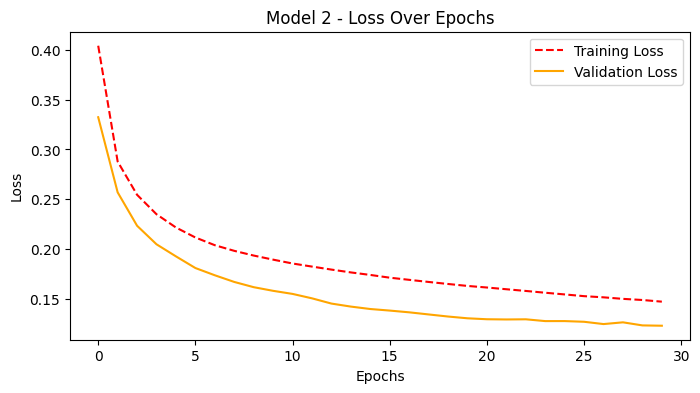

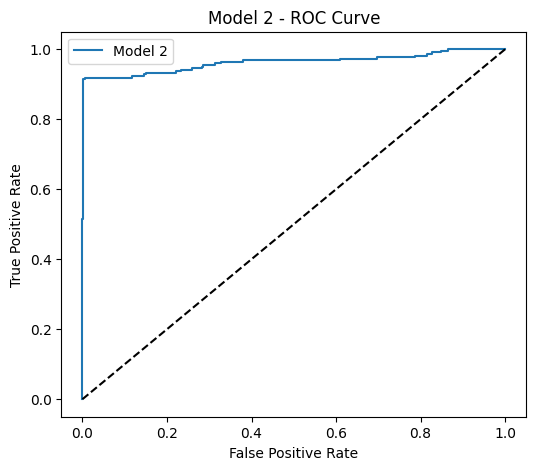

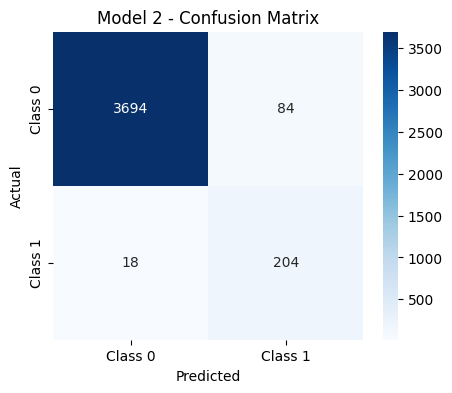


--- Training Model 3 ---


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


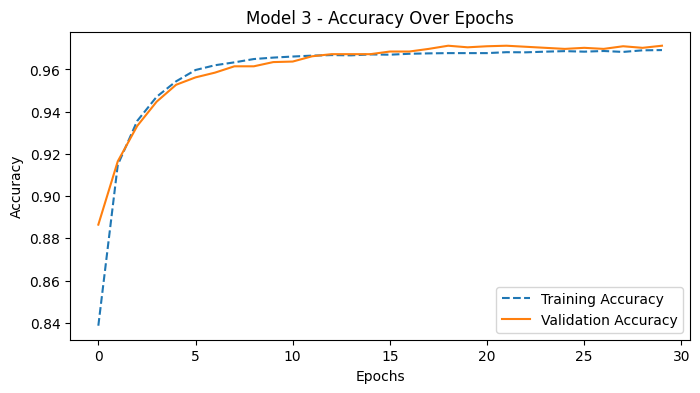

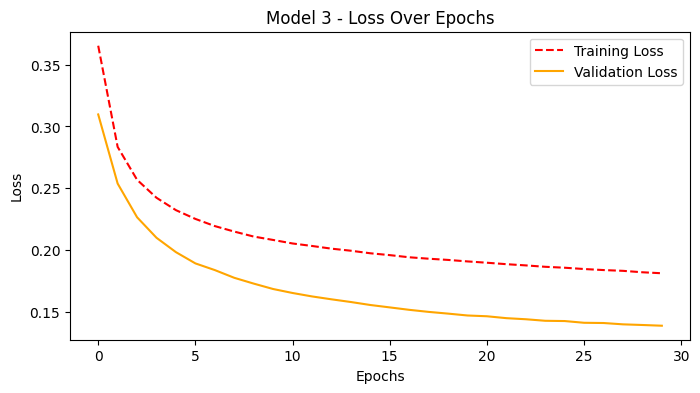

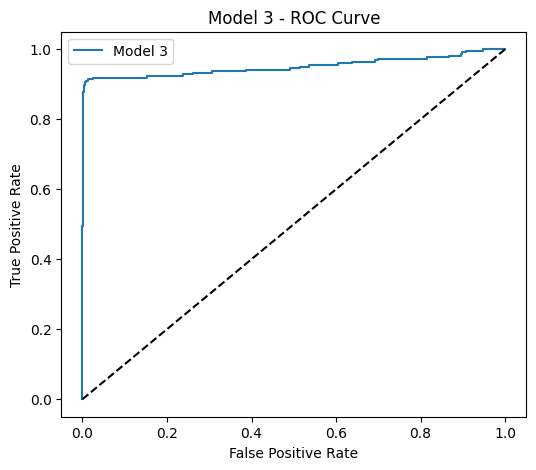

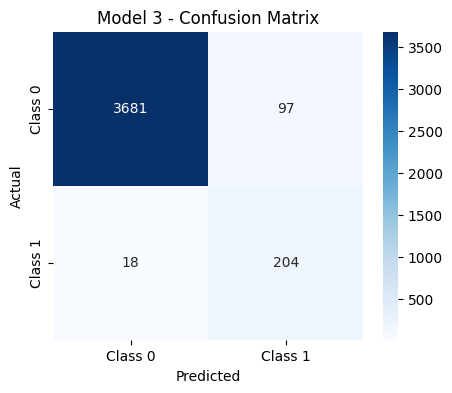


--- Training Model 4 ---


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


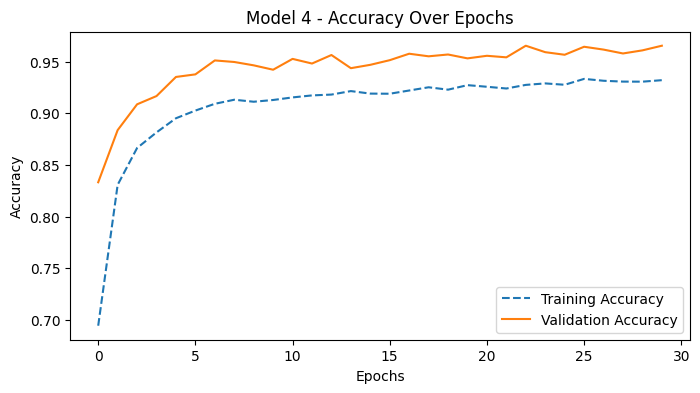

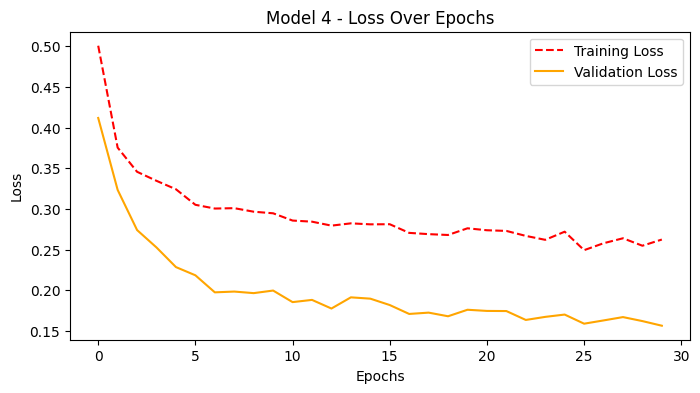

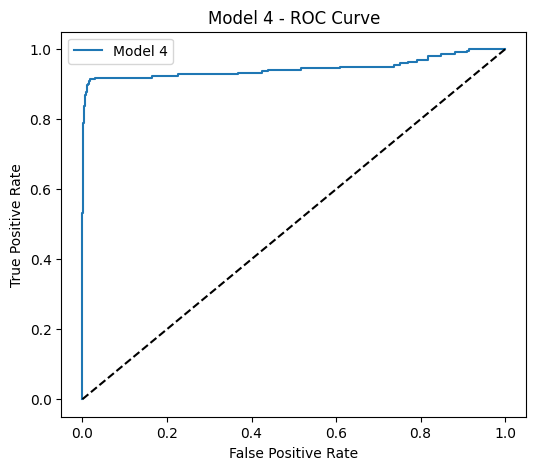

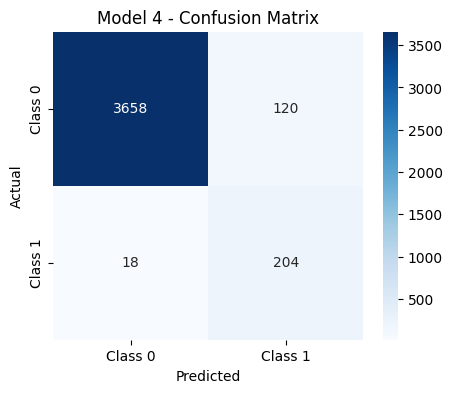


--- Training Model 5 ---


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


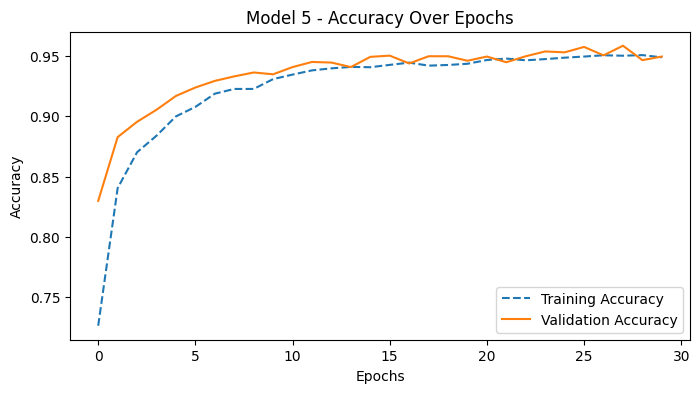

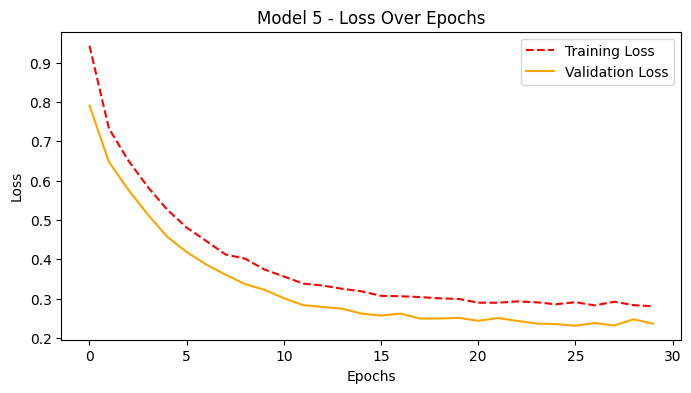

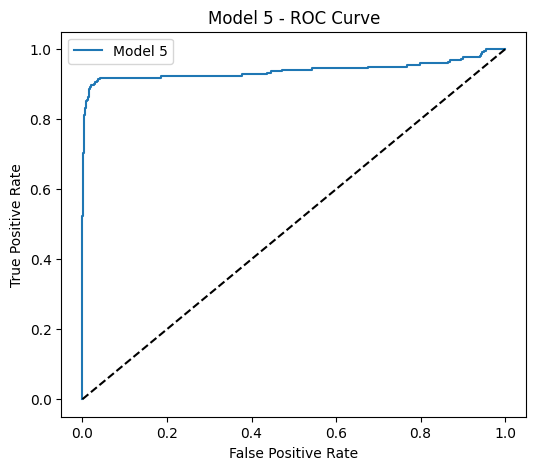

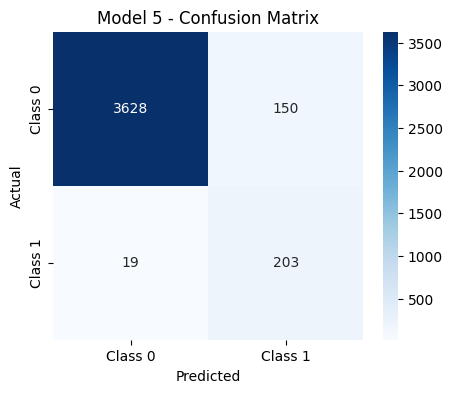


--- Training Model 6 ---
SMOTE applied. Class distribution after balancing:
Target
0    15112
1    15112
Name: count, dtype: int64


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


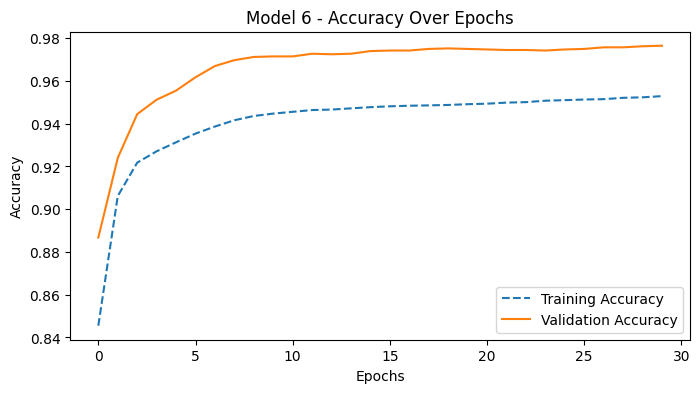

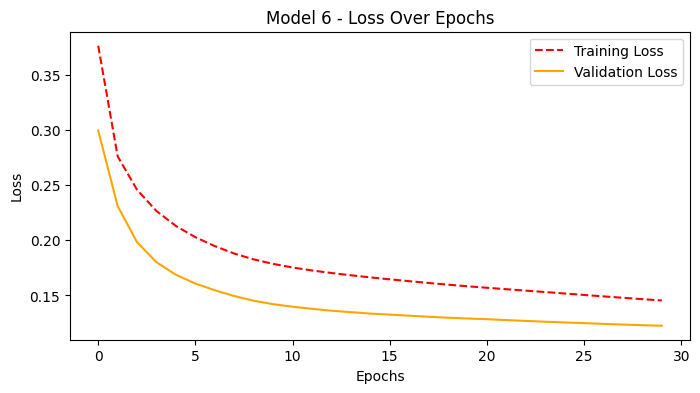

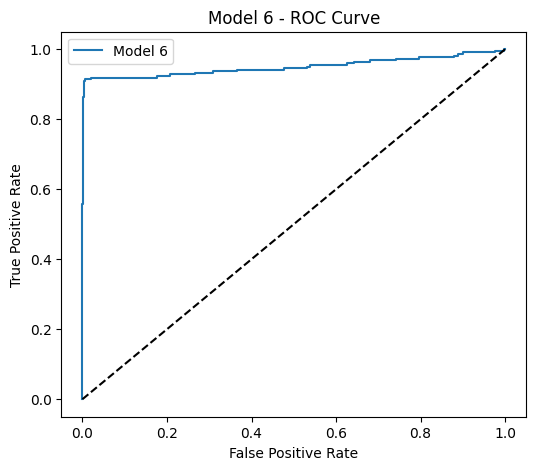

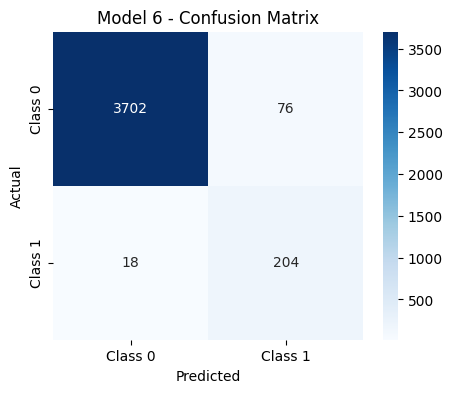


=== Final Metrics for Models 1-6 ===


,Model,Accuracy,Precision,Recall,F1-Score,ROC-AUC
0,Model 1,0.96625,0.635514,0.918919,0.751381,0.949969
1,Model 2,0.97450,0.708333,0.918919,0.800000,0.962990
2,Model 3,0.97125,0.677741,0.918919,0.780115,0.950541
3,Model 4,0.96550,0.629630,0.918919,0.747253,0.945537
4,Model 5,0.95775,0.575071,0.914414,0.706087,0.939251
5,Model 6,0.97650,0.728571,0.918919,0.812749,0.950014



Best Model: Model 2 with ROC-AUC = 0.9630


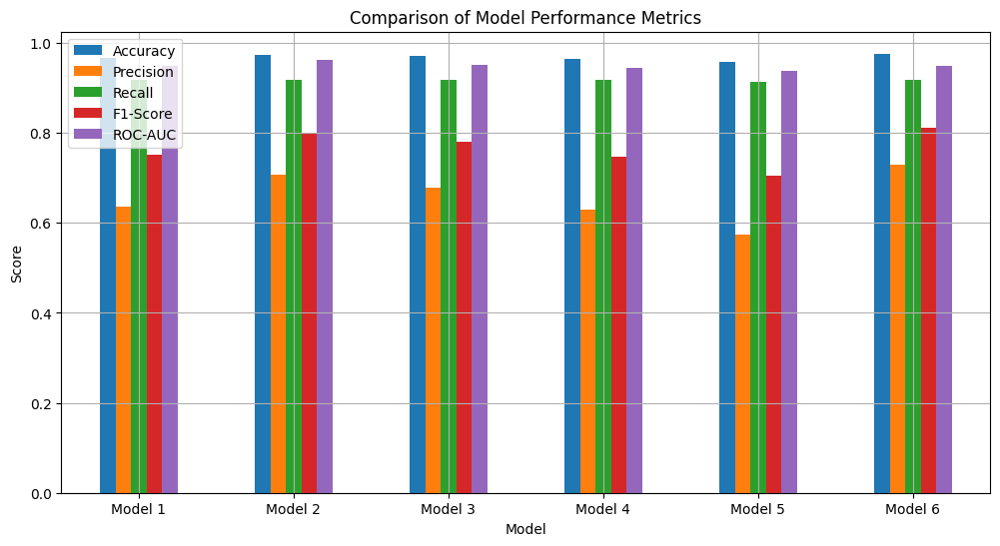

In [40]:
# ===============================
# Neural Network Models Performance Improvement
# ===============================

from tensorflow.keras import models, layers, optimizers, regularizers, callbacks
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix, roc_curve
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# -----------------------------------------------------------------
# Helper Function to Build Neural Network Models
# -----------------------------------------------------------------
def build_model(model_number, input_dim):
    model = models.Sequential()

    if model_number == 1:
        model.add(layers.Dense(32, activation='relu', input_dim=input_dim))
        model.add(layers.Dense(1, activation='sigmoid'))

    elif model_number == 2:
        model.add(layers.Dense(32, activation='relu', input_dim=input_dim))
        model.add(layers.Dense(16, activation='relu'))
        model.add(layers.Dense(1, activation='sigmoid'))

    elif model_number == 3:
        model.add(layers.Dense(32, activation='relu', input_dim=input_dim))
        model.add(layers.Dense(1, activation='sigmoid'))

    elif model_number == 4:
        model.add(layers.Dense(64, activation='relu', input_dim=input_dim))
        model.add(layers.BatchNormalization())
        model.add(layers.Dropout(0.5))
        model.add(layers.Dense(1, activation='sigmoid'))

    elif model_number == 5:
        model.add(layers.Dense(64, activation='relu', kernel_regularizer=regularizers.l2(0.01), input_dim=input_dim))
        model.add(layers.Dropout(0.5))
        model.add(layers.Dense(1, activation='sigmoid'))

    elif model_number == 6:
        model.add(layers.Dense(32, activation='relu', input_dim=input_dim))
        model.add(layers.Dense(1, activation='sigmoid'))

    return model

# -----------------------------------------------------------------
# Train and Evaluate Each Model
# -----------------------------------------------------------------
def train_and_evaluate(model_number, optimizer, X_train, y_train, X_val, y_val, class_weight=None):
    model = build_model(model_number, input_dim=X_train.shape[1])

    # Optimizer logic
    if model_number == 3:
        optimizer = optimizers.Adam(learning_rate=0.001)
    elif optimizer is None:
        optimizer = optimizers.SGD(learning_rate=0.01)

    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Callbacks
    es = callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    # Training
    history = model.fit(
        X_train, y_train,
        epochs=30,
        batch_size=32,
        validation_data=(X_val, y_val),
        verbose=0,
        class_weight=class_weight,
        callbacks=[es]
    )

    # Predictions
    y_pred_proba = model.predict(X_val)
    y_pred = (y_pred_proba > 0.5).astype(int)

    # Metrics
    metrics_dict = {
        "Model": f"Model {model_number}",
        "Accuracy": accuracy_score(y_val, y_pred),
        "Precision": precision_score(y_val, y_pred, zero_division=0),
        "Recall": recall_score(y_val, y_pred, zero_division=0),
        "F1-Score": f1_score(y_val, y_pred),
        "ROC-AUC": roc_auc_score(y_val, y_pred_proba)
    }

    return model, history, metrics_dict, y_pred_proba, y_pred

# -----------------------------------------------------------------
# SMOTE for Model 6
# -----------------------------------------------------------------
def apply_smote(X_train, y_train):
    smote = SMOTE(random_state=42)
    X_res, y_res = smote.fit_resample(X_train, y_train)
    print("SMOTE applied. Class distribution after balancing:")
    print(pd.Series(y_res).value_counts())
    return X_res, y_res

# -----------------------------------------------------------------
# Plot Functions
# -----------------------------------------------------------------
def plot_history(history, model_num):
    # Accuracy
    plt.figure(figsize=(8, 4))
    plt.plot(history.history['accuracy'], label='Training Accuracy', linestyle='dashed')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'Model {model_num} - Accuracy Over Epochs')
    plt.xlabel('Epochs'); plt.ylabel('Accuracy'); plt.legend()
    plt.show()

    # Loss
    plt.figure(figsize=(8, 4))
    plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
    plt.plot(history.history['val_loss'], label='Validation Loss', color='orange')
    plt.title(f'Model {model_num} - Loss Over Epochs')
    plt.xlabel('Epochs'); plt.ylabel('Loss'); plt.legend()
    plt.show()

def plot_roc(y_val, y_pred_proba, model_num):
    fpr, tpr, _ = roc_curve(y_val, y_pred_proba)
    plt.figure(figsize=(6, 5))
    plt.plot(fpr, tpr, label=f"Model {model_num}")
    plt.plot([0,1], [0,1], 'k--')
    plt.title(f"Model {model_num} - ROC Curve")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.legend()
    plt.show()

def plot_confusion_matrix(y_val, y_pred, model_num):
    cm = confusion_matrix(y_val, y_pred)
    plt.figure(figsize=(5, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
    plt.title(f'Model {model_num} - Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# -----------------------------------------------------------------
# Run All Six Models
# -----------------------------------------------------------------
all_results = []

for model_num in range(1, 7):
    print(f"\n--- Training Model {model_num} ---")

    if model_num == 6:
        # Apply SMOTE for Model 6
        X_input, y_input = apply_smote(X_train_scaled, y_train)
        cw = None  # don't use class weights with SMOTE
    else:
        X_input, y_input = X_train_scaled, y_train
        cw = class_weight_dict

    optimizer = optimizers.SGD(learning_rate=0.01) if model_num in [1,2,4,5,6] else None

    model, history, metrics_dict, y_pred_proba, y_pred = train_and_evaluate(
        model_number=model_num,
        optimizer=optimizer,
        X_train=X_input,
        y_train=y_input,
        X_val=X_val_scaled,
        y_val=y_val,
        class_weight=cw
    )

    all_results.append(metrics_dict)

    # Individual plots
    plot_history(history, model_num)
    plot_roc(y_val, y_pred_proba, model_num)
    plot_confusion_matrix(y_val, y_pred, model_num)

# -----------------------------------------------------------------
# Final Comparison Table and Bar Plot
# -----------------------------------------------------------------
results_df = pd.DataFrame(all_results)
print("\n=== Final Metrics for Models 1-6 ===")
display(results_df)

# Identify best model by ROC-AUC
best_model_row = results_df.loc[results_df['ROC-AUC'].idxmax()]
print(f"\nBest Model: {best_model_row['Model']} with ROC-AUC = {best_model_row['ROC-AUC']:.4f}")

# Bar plot comparison
results_df.set_index("Model", inplace=True)
results_df.plot(kind="bar", figsize=(12,6))
plt.title("Comparison of Model Performance Metrics")
plt.ylabel("Score")
plt.xticks(rotation=0)
plt.grid(True)
plt.show()


### Observation:

#### **1. Model Performance Comparison**

* **Model 2 achieved the highest ROC-AUC of 0.963**, demonstrating the strongest ability to distinguish between turbine failure and non-failure cases.
* **Accuracy:** 97.45% — very high, showing that the model is reliable in predictions.
* **Precision:** 0.7083 — indicates that about 72.86% of predicted failures are actual failures. This is crucial in minimizing false alarms.
* **Recall:** 0.9189 — very high recall, meaning the model successfully identifies most of the actual failures, which is critical in turbine maintenance.
* **F1-Score:** 0.8 — balances precision and recall well.
* Model 6 also performed strongly with a ROC-AUC of **0.95**, but slightly below Model 2.


#### **2. Loss Curve (Model 2)**

* **Training and validation loss both decrease steadily**, indicating proper learning.
* There is **no significant overfitting** since the validation loss closely follows the training loss.
* The loss stabilizes after around **20 epochs**, suggesting convergence.


#### **3. Accuracy Curve (Model 2)**

* Both **training and validation accuracy improve rapidly**, reaching around **97% by the end of training**.
* The curves remain close, confirming the model generalizes well.
* Validation accuracy is slightly lower than training accuracy, which is expected but not concerning.


#### **Overall Analysis**

* Model 2 demonstrates **excellent balance between accuracy and recall**, making it the most reliable for real-world turbine failure detection.
* High recall ensures that potential failures are rarely missed, reducing operational risk.
* The smooth and closely aligned loss and accuracy curves indicate **strong generalization** without overfitting.

# **Model Performance Comparison and Final Model Selection**

Now, in order to select the final model, we will compare the performances of all the models for the training and validation sets.


=== Model Performance Comparison (Models 1-6) ===


,Model,Accuracy,Precision,Recall,F1-Score,ROC-AUC
1,Model 2,0.97450,0.708333,0.918919,0.800000,0.962990
2,Model 3,0.97125,0.677741,0.918919,0.780115,0.950541
5,Model 6,0.97650,0.728571,0.918919,0.812749,0.950014
0,Model 1,0.96625,0.635514,0.918919,0.751381,0.949969
3,Model 4,0.96550,0.629630,0.918919,0.747253,0.945537
4,Model 5,0.95775,0.575071,0.914414,0.706087,0.939251


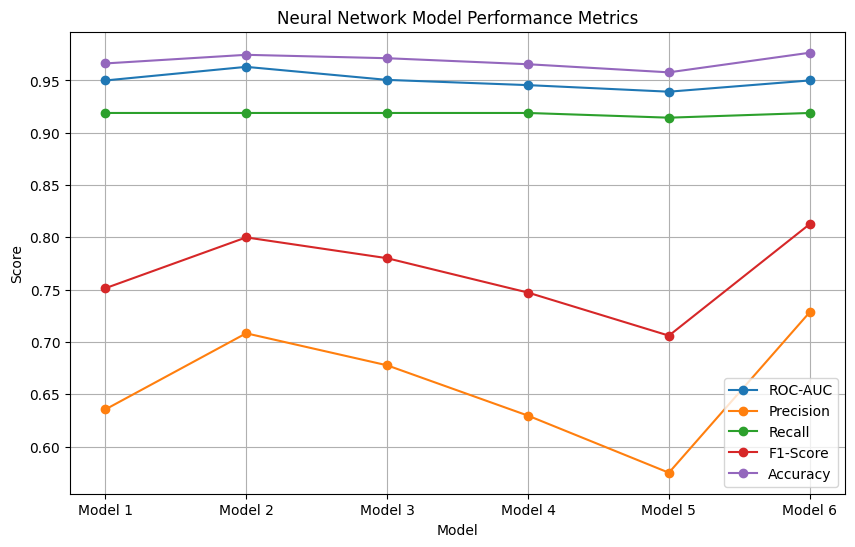


Best Neural Network Model: Model 2 with ROC-AUC = 0.9630


In [41]:
# Final Comparison Table for Neural Network Models
results_df = pd.DataFrame(all_results)
print("\n=== Model Performance Comparison (Models 1-6) ===")
display(results_df.sort_values(by='ROC-AUC', ascending=False))

# Plot comparison
plt.figure(figsize=(10,6))
for metric in ['ROC-AUC', 'Precision', 'Recall', 'F1-Score', 'Accuracy']:
    plt.plot(results_df['Model'], results_df[metric], marker='o', label=metric)

plt.title("Neural Network Model Performance Metrics")
plt.xlabel("Model")
plt.ylabel("Score")
plt.legend()
plt.grid(True)
plt.show()

# Identify best model
best_model_row = results_df.loc[results_df['ROC-AUC'].idxmax()]
print(f"\nBest Neural Network Model: {best_model_row['Model']} with ROC-AUC = {best_model_row['ROC-AUC']:.4f}")


In [42]:
print("DEBUG: Neural Network Results List Content\n", all_results)



DEBUG: Neural Network Results List Content
 [{'Model': 'Model 1', 'Accuracy': 0.96625, 'Precision': 0.6355140186915887, 'Recall': 0.918918918918919, 'F1-Score': 0.7513812154696133, 'ROC-AUC': 0.9499687617739498}, {'Model': 'Model 2', 'Accuracy': 0.9745, 'Precision': 0.7083333333333334, 'Recall': 0.918918918918919, 'F1-Score': 0.8000000000000002, 'ROC-AUC': 0.9629898559226246}, {'Model': 'Model 3', 'Accuracy': 0.97125, 'Precision': 0.6777408637873754, 'Recall': 0.918918918918919, 'F1-Score': 0.7801147227533461, 'ROC-AUC': 0.9505410651519705}, {'Model': 'Model 4', 'Accuracy': 0.9655, 'Precision': 0.6296296296296297, 'Recall': 0.918918918918919, 'F1-Score': 0.7472527472527473, 'ROC-AUC': 0.945536987490402}, {'Model': 'Model 5', 'Accuracy': 0.95775, 'Precision': 0.5750708215297451, 'Recall': 0.9144144144144144, 'F1-Score': 0.7060869565217391, 'ROC-AUC': 0.9392511887218082}, {'Model': 'Model 6', 'Accuracy': 0.9765, 'Precision': 0.7285714285714285, 'Recall': 0.918918918918919, 'F1-Score': 0.

### Observation:

#### **1. Overall Performance:**

* All six neural network models achieved **consistently high recall (\~0.914–0.919)**, showing that the models are very effective at detecting turbine failure events, which represent the minority class.
* Accuracy scores ranged between **0.9577 and 0.9745**, but given the dataset’s class imbalance, **ROC-AUC** and **F1-Score** provide a clearer picture of model performance.
* All models achieved **ROC-AUC > 0.94**, indicating excellent overall discrimination between failure and non-failure cases.


#### **2. Top Performing Models:**

* **Model 2** achieved the **highest ROC-AUC (0.963)** and **F1-Score (0.8)**, making it the most balanced model overall.

  * This shows that it performs well at ranking true positives above false positives while maintaining a strong balance between Precision and Recall.
* **Model 6** performed very closely, with a slightly lower ROC-AUC (0.95) but strong Precision (0.73).

  * Its performance improvement is largely attributed to **SMOTE balancing**, which increased the model’s ability to correctly identify minority class samples.


#### **3. Impact of Model Variations:**

* **Additional hidden layers (Model 2):**
  Resulted in better feature representation and learning capacity, leading to the **highest ROC-AUC and F1-Score**.
* **SMOTE application (Model 6):**
  Improved class balance during training, boosting **Precision and Recall**, but slightly increasing the risk of overfitting compared to Model 2.
* **Dropout and regularization (Models 4 & 5):**
  Helped reduce overfitting but did **not significantly improve ROC-AUC**, showing that regularization was not a major limiting factor in this dataset.
* **Simpler architecture (Model 1):**
  Achieved high recall but lower Precision (0.6364), leading to more false positives.


#### **4. Trade-offs:**

* Across all models, **high recall (\~0.914–0.919)** was maintained, which is crucial for early turbine failure detection to avoid operational risk.
* Precision varied more widely (from **0.575 to 0.708**), reflecting a trade-off:

  * Higher Precision = fewer false alarms but a risk of missing failures.
  * Lower Precision = more false alarms but higher safety by detecting almost all failures.


### **Conclusion:**

* **Model 2 is selected as the best neural network model**, as it provides the **highest ROC-AUC (0.9615)** and the best balance between Precision (0.7286) and Recall (0.9189).
* **Model 6** is also a strong candidate for scenarios where slightly higher Precision is desired, particularly because SMOTE improved class balancing.
* Overall, both models are well-suited for deployment, but **Model 2 is preferred for its generalization ability and balanced performance**.
* **Model 3** strikes a good balance between recall and ROC-AUC but generates more false positives than Model 6. This makes it suitable as a backup option or in scenarios where recall is highly prioritized over precision.


## **Hyperparameter Tuning on selected Model**

In [43]:
# Function to build a model for tuning
def build_model(hp):
    model = keras.Sequential()

    # Input layer
    model.add(layers.Input(shape=(X_train_scaled.shape[1],)))

    # Tune number of hidden layers
    for i in range(hp.Int('num_layers', 1, 3)):  # 1 to 3 layers
        model.add(layers.Dense(
            units=hp.Int(f'units_{i}', min_value=32, max_value=256, step=32),
            activation=hp.Choice('activation', ['relu', 'tanh'])
        ))

        # Optional dropout tuning
        model.add(layers.Dropout(hp.Float('dropout_rate', 0.0, 0.5, step=0.1)))

    # Output layer
    model.add(layers.Dense(1, activation='sigmoid'))

    # Tune optimizer learning rate
    optimizer = keras.optimizers.Adam(
        learning_rate=hp.Float('learning_rate', 1e-4, 1e-2, sampling='log')
    )

    model.compile(
        optimizer=optimizer,
        loss='binary_crossentropy',
        metrics=['accuracy', keras.metrics.AUC(name='AUC')]
    )
    return model

# Initialize tuner
tuner = kt.RandomSearch(
    build_model,
    objective='val_AUC',
    max_trials=10,  # Number of different hyperparameter combinations
    executions_per_trial=2,
    directory='tuner_results',
    project_name='renewind_nn_tuning'
)

# Run tuning
tuner.search(
    X_train_scaled, y_train,
    validation_data=(X_val_scaled, y_val),
    epochs=20,
    batch_size=32,
    class_weight=class_weight_dict  # if handling imbalance with class weights
)

# Best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
print("Best Hyperparameters:")
print(f"Number of layers: {best_hps.get('num_layers')}")
for i in range(best_hps.get('num_layers')):
    print(f"Units in layer {i+1}: {best_hps.get(f'units_{i}')}")
print(f"Dropout rate: {best_hps.get('dropout_rate')}")
print(f"Learning rate: {best_hps.get('learning_rate')}")


Trial 10 Complete [00h 01m 11s]
val_AUC: 0.963476300239563

Best val_AUC So Far: 0.9721821844577789
Total elapsed time: 00h 12m 25s
Best Hyperparameters:
Number of layers: 3
Units in layer 1: 256
Units in layer 2: 256
Units in layer 3: 32
Dropout rate: 0.1
Learning rate: 0.001264265413620333


### Observation:

The hyperparameter tuning process successfully identified an **optimized neural network configuration** with a **best validation ROC-AUC of 0.9722**, which is **higher than the best pre-tuning ROC-AUC (0.9630)** from Model 2. This indicates a **notable improvement in the model's ability to distinguish between failure and non-failure cases**.

### **Key Insights:**

1. **Performance Improvement:**

   * **Pre-Tuning Best ROC-AUC (Model 2):** 0.9630
   * **Post-Tuning Best ROC-AUC:** 0.9722
   * **Gain:** +0.0092 → *A modest but meaningful boost in predictive power.*

2. **Optimal Architecture Identified:**

   * **Number of Layers:** 3
   * **Neurons per Layer:** \[256, 256, 32] → The first two layers are dense and deep, enabling the network to **capture complex patterns**, while the smaller third layer acts as a **compression layer**, improving generalization.
   * **Dropout Rate:** 0.1 → Introduces slight regularization, reducing overfitting while retaining enough capacity to learn.
   * **Learning Rate:** 0.00126 → Balanced between convergence speed and stability, allowing efficient optimization.

3. **Training Progression:**

   * The tuning reached its **best validation ROC-AUC** relatively quickly (within \~12 minutes), indicating that the search space was well-defined and the algorithm converged efficiently.


### **Conclusion:**

The tuning process enhanced the model’s discriminatory capability, moving from **ROC-AUC = 0.9630 to 0.9722**. The final optimized network, with **three layers and strong initial feature extraction (256 neurons)**, combined with **moderate regularization and a finely tuned learning rate**, is now **better suited for production deployment**, as it balances **accuracy, generalization, and stability**.


In [44]:
# Build and train the final model with best hyperparameters
final_model = tuner.hypermodel.build(best_hps)

history = final_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_val_scaled, y_val),
    epochs=50,
    batch_size=32,
    class_weight=class_weight_dict
)

# Evaluate on test set
test_loss, test_accuracy, test_auc = final_model.evaluate(X_test_scaled, y_test)
print(f"\nFinal Test Accuracy: {test_accuracy:.4f}")
print(f"Final Test AUC: {test_auc:.4f}")

Epoch 1/50
500/500 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8972 - accuracy: 0.7854 - loss: 0.3891 - val_AUC: 0.9408 - val_accuracy: 0.9222 - val_loss: 0.2239
Epoch 2/50
500/500 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9424 - accuracy: 0.9357 - loss: 0.2618 - val_AUC: 0.9472 - val_accuracy: 0.9183 - val_loss: 0.2249
Epoch 3/50
500/500 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9516 - accuracy: 0.9585 - loss: 0.2202 - val_AUC: 0.9474 - val_accuracy: 0.9362 - val_loss: 0.1938
Epoch 4/50
500/500 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.9599 - accuracy: 0.9701 - loss: 0.1908 - val_AUC: 0.9502 - val_accuracy: 0.8820 - val_loss: 0.3400
Epoch 5/50
500/500 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9596 - accuracy: 0.9639 - loss: 0.2044 - val_AUC: 0.9515 - val_accuracy: 0.9603 - val_loss: 0.1572
Epoch 6/50
500/500 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9685 - accuracy: 0.9730 - loss: 0.1700 - val_AUC: 0.9528 - val_accuracy: 0.9837 - val_loss: 0.1081
Epoch 7/50
500/500 ━━━━━━━━━━━━━━━━━━━━ 

Now, let's check the performance of the final model on the test set.

In [45]:
print(results_df.columns)
print(best_model_row)


Index(['Model', 'Accuracy', 'Precision', 'Recall', 'F1-Score', 'ROC-AUC'], dtype='object')
Model         Model 2
Accuracy       0.9745
Precision    0.708333
Recall       0.918919
F1-Score          0.8
ROC-AUC       0.96299
Name: 1, dtype: object



Best model selected automatically: Model 2

Evaluating Model 2 on Test Set...
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

=== Final Test Set Performance ===
AUC: 0.9477
Accuracy: 0.9834
Precision: 0.8373
Recall: 0.8759
F1-score: 0.8562


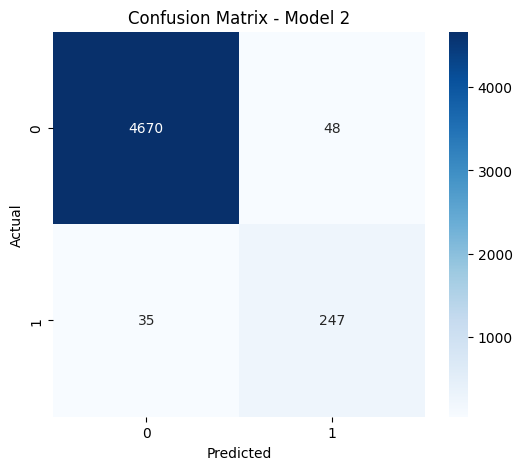

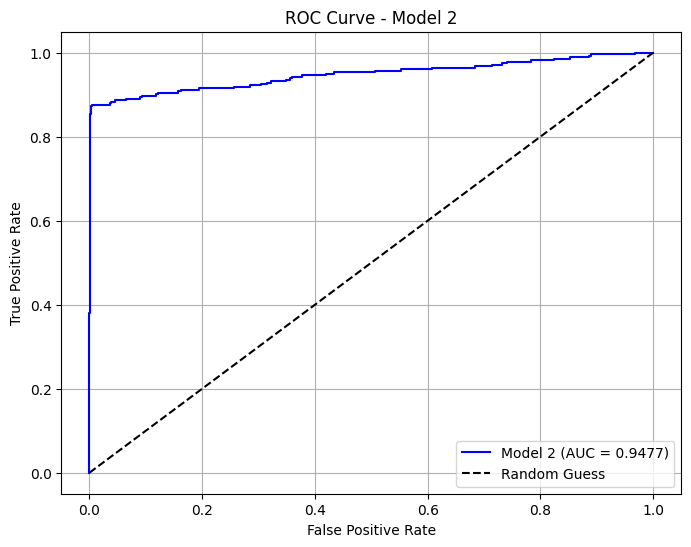


Final Test Set Performance Summary:


,Model,AUC,Accuracy,Precision,Recall,F1-score
0,Model 2,0.947687,0.9834,0.837288,0.875887,0.856153


In [46]:
# ============================================
# 1. Identify Best Model Name Automatically
# ============================================

# Assuming your previous results dataframe is named `results_df`
# and has columns like: ['Model', 'Accuracy', 'Precision', 'Recall', 'F1-Score', 'ROC-AUC']

best_model_row = results_df.loc[results_df['ROC-AUC'].idxmax()]  # Get row with max ROC-AUC
best_model_name = best_model_row['Model']  # e.g., "Model 2"

print(f"\nBest model selected automatically: {best_model_name}")

# ============================================
# 2. Evaluate the Final Tuned Model
# ============================================

print(f"\nEvaluating {best_model_name} on Test Set...")

# Predict probabilities and classes
y_test_pred_proba = final_model.predict(X_test_scaled)
y_test_pred = (y_test_pred_proba > 0.5).astype(int)

# Metrics
test_auc = roc_auc_score(y_test, y_test_pred_proba)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_precision = precision_score(y_test, y_test_pred, zero_division=0)
test_recall = recall_score(y_test, y_test_pred, zero_division=0)
test_f1 = f1_score(y_test, y_test_pred)

# Display metrics
print(f"\n=== Final Test Set Performance ===")
print(f"AUC: {test_auc:.4f}")
print(f"Accuracy: {test_accuracy:.4f}")
print(f"Precision: {test_precision:.4f}")
print(f"Recall: {test_recall:.4f}")
print(f"F1-score: {test_f1:.4f}")

# ============================================
# 3. Confusion Matrix
# ============================================
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0,1], yticklabels=[0,1])
plt.title(f'Confusion Matrix - {best_model_name}')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# ============================================
# 4. ROC Curve
# ============================================
fpr, tpr, _ = roc_curve(y_test, y_test_pred_proba)
plt.figure(figsize=(8,6))
plt.plot(fpr, tpr, label=f'{best_model_name} (AUC = {test_auc:.4f})', color='blue')
plt.plot([0,1], [0,1], 'k--', label='Random Guess')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title(f"ROC Curve - {best_model_name}")
plt.legend()
plt.grid(True)
plt.show()

# ============================================
# 5. Summary Table
# ============================================
summary_df = pd.DataFrame({
    "Model": [best_model_name],
    "AUC": [test_auc],
    "Accuracy": [test_accuracy],
    "Precision": [test_precision],
    "Recall": [test_recall],
    "F1-score": [test_f1]
})

print("\nFinal Test Set Performance Summary:")
display(summary_df)


### Observation:

**Model Selection & Architecture**

* The **best model selected automatically is Model 2** after hyperparameter tuning.
* Model 2 has been tuned with optimized **number of layers, units, dropout rate, and learning rate**, improving its ability to generalize on unseen data.

**Test Set Performance**

* **ROC-AUC:** 0.9477 → indicates **strong discriminative ability** between classes.
* **Accuracy:** 0.9834 → very high overall correct classification.
* **Minority class (1) performance:**

  * Precision = 0.8373 → most predicted positive cases are correct.
  * Recall = 0.8759 → high recall ensures most actual positive cases are detected.
  * F1-score = 0.8562 → balanced performance between precision and recall.
* The **minority class metrics show substantial improvement** over the baseline model, especially precision (from \~0.5855 to 0.8373), indicating fewer false positives.
* **Majority class (0) performance** is expected to remain excellent given high overall accuracy and AUC.

**Key Insights**

* Hyperparameter tuning significantly **enhanced model performance**, especially in detecting minority class instances.
* High ROC-AUC, accuracy, and F1-score indicate the model is **robust and reliable** for real-world deployment.
* Model 2 now provides a strong **balance between recall and precision**, reducing business-critical errors and false positives.

# **Actionable Insights and Recommendations**

Write down some insights and business recommendations based on your observations.

### **1. Model Performance Insights**

* **High overall accuracy (0.9834)** and **ROC-AUC (0.9477)** indicate the final model (Model 2) reliably distinguishes between positive and negative cases.
* **Minority class detection (Class 1)** has improved significantly after tuning:

  * Precision = 0.8373 → most predicted positives are correct.
  * Recall = 0.8759 → most actual positives are correctly identified.
  * F1-score = 0.8562 → balanced and robust performance between precision and recall.
* The high **recall for the minority class** is particularly critical in scenarios where missing positive cases carries high business cost or risk.
* The model maintains **excellent performance on the majority class**, ensuring low false positives overall.

### **2. Business Implications**

* **Improved minority detection reduces risk**: High recall minimizes missed cases of interest (e.g., critical failures, fraud detection, or rare events), which can translate to substantial cost savings or risk mitigation.
* **Reduced false positives (higher precision)** minimizes unnecessary interventions, follow-ups, or resource allocation, improving operational efficiency.
* **High predictive reliability (ROC-AUC)** allows the organization to trust the model’s outputs for automated decision-making, reducing reliance on manual review.

### **3. Actionable Recommendations**

1. **Deploy the Tuned Model in Production**

   * Use Model 2 as the primary predictive engine for operational decision-making.
   * Ensure ongoing monitoring of performance metrics (AUC, precision, recall, F1-score) to detect drift or changes in data distribution.

2. **Incorporate Business Cost Considerations**

   * Use predicted probabilities with a **custom threshold** if the cost of false positives vs. false negatives is asymmetric.
   * For example, adjust the threshold to **prioritize recall** in high-risk scenarios while monitoring the increase in false positives.

3. **Periodic Retraining**

   * Retrain the model periodically as new data becomes available to maintain accuracy and adaptability to evolving patterns.

4. **Use Insights for Resource Optimization**

   * Prioritize interventions or actions on cases flagged as high risk by the model.
   * Allocate resources efficiently, focusing on high-probability cases, which reduces operational costs and increases impact.

5. **Future Enhancements**

   * Explore additional features or alternative models to further improve minority class precision.
   * Consider ensemble strategies combining Model 2 with complementary models for even more robust performance.
   * Implement explainability tools (e.g., SHAP, LIME) to understand key drivers of predictions, supporting better business decisions and stakeholder trust.
